# Object Detection  Cases : Ships Detection

- Main Goals:

We want to identify and detect ships that passed certain area of our location

- Dataset Information:

This dataset contains a vast collection of 26.9k images, which have been carefully annotated for the specific purpose of ship detection. The bounding box annotations are presented in the YOLO format, which allows for accurate and efficient detection of the ships in the images. The dataset has been curated to include images of only one class "ship".

# Importing Libraries

In [1]:
!pip install ultralytics
from ultralytics import YOLO

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 15.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 37.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 37.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 37.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 43.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

In [2]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import cv2
from collections import defaultdict
import random
import zipfile
import glob


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
zip_path = '/content/drive/MyDrive/Aerial-Ship-Image-Datasets/ships-aerial-images.zip'
extract_to = '/content/dataset'

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)


# Import Datasets

In [7]:
image_counts = {}
splits = ["train", "test", "valid"]
for split in splits:
    image_dir = os.path.join(extract_to, "ships-aerial-images", split, "images")
    image_counts[split] = len(glob.glob(os.path.join(image_dir, "*")))

print("Image counts per split:", image_counts)


Image counts per split: {'train': 9697, 'test': 1573, 'valid': 2165}


There are roughly ten thousand pictures for teaching the model, a couple of thousand to see how it’s doing while it learns, and about one and a half thousand kept aside for the final scorecard so most of the images help it learn, and the rest help us check that it isn’t just memorising and can truly recognise new ship photos. but anyways, the percentage of the splits is:
1. Training: 72.18 %
2. Validation: 16.11 %
3. Test: 11.71 %

In [8]:
train_images = "/content/dataset/ships-aerial-images/train/images"
train_labels = "/content/dataset/ships-aerial-images/train/labels"

test_images = "/content/dataset/ships-aerial-images/test/images"
test_labels = "/content/dataset/ships-aerial-images/test/labels"

val_images = "/content/dataset/ships-aerial-images/valid/images"
val_labels = "/content/dataset/ships-aerial-images/valid/labels"


# EDA

## EDA For Image

### Sample Visualization Image

for the first step of eda, we're going to randomly select images of ships with their corresponding bounding boxes, to get a gist of the raw data that we're dealing with

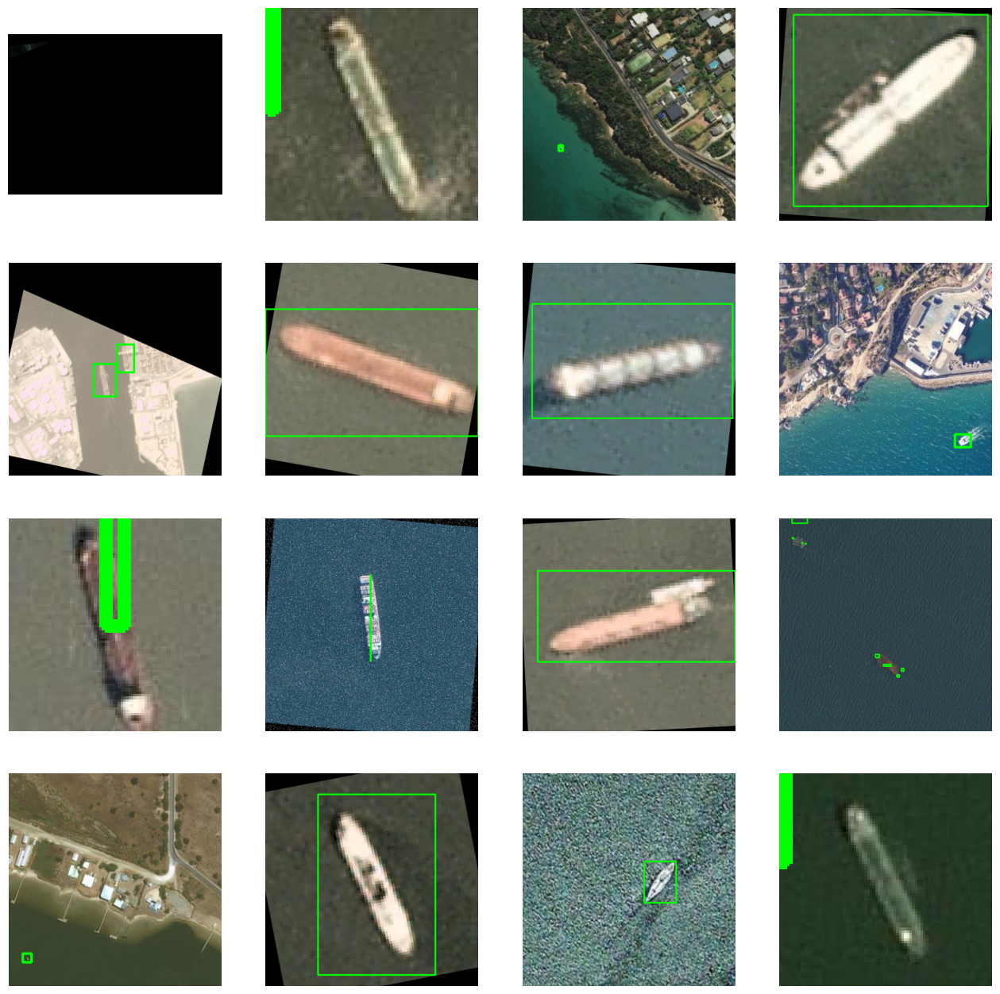

In [9]:
image_files = os.listdir(train_images)

random_images = random.sample(image_files, 16)

fig, axs = plt.subplots(4, 4, figsize=(16, 16))
for i, image_file in enumerate(random_images):
    row = i // 4
    col = i % 4

    image_path = os.path.join(train_images, image_file)
    image = cv2.imread(image_path)

    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(train_labels, label_file)
    with open(label_path, "r") as f:
        labels = f.read().strip().split("\n")

    for label in labels:
        if len(label.split()) != 5:
            continue
        class_id, x_center, y_center, width, height = map(float, label.split())
        x_min = int((x_center - width/2) * image.shape[1])
        y_min = int((y_center - height/2) * image.shape[0])
        x_max = int((x_center + width/2) * image.shape[1])
        y_max = int((y_center + height/2) * image.shape[0])
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 3)


    # Show the image with the object detections
    axs[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[row, col].axis('off')

plt.show()

### Checking Ratio Image

next we're going to check various attributes of our images, including their file type, aspect ratio, resolution

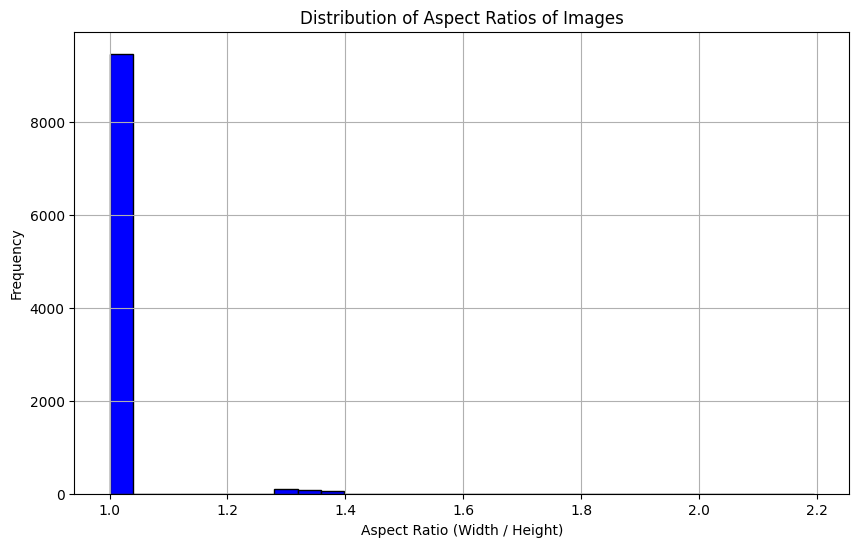

In [10]:
image_files = os.listdir(train_images)

# List to store the aspect ratios
aspect_ratios = []

# Loop through each image file
for image_file in image_files:
    # Construct the image path
    image_path = os.path.join(train_images, image_file)

    # Read the image using OpenCV
    image = cv2.imread(image_path)

    # Check if image is loaded correctly
    if image is not None:
        # Get the dimensions (height, width, channels) of the image
        height, width, _ = image.shape

        # Calculate the aspect ratio (width / height)
        aspect_ratio = width / height
        aspect_ratios.append(aspect_ratio)

# Plot the distribution of aspect ratios
plt.figure(figsize=(10, 6))
plt.hist(aspect_ratios, bins=30, color='blue', edgecolor='black')
plt.title('Distribution of Aspect Ratios of Images')
plt.xlabel('Aspect Ratio (Width / Height)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

as we can see from the plot above, majority of our images are in the desired 1:1 aspect ratio, however there are few that exceed this desired ratio. Later in the preprocessing we will convert all of the image to a ratio 1:1 so it will be easy for us to  train it later with the same image ratio size. it's because In object detection, maintaining a consistent aspect ratio between training and inference images is crucial because altering the ratio can distort objects, causing the model’s learned features such as shape, size, and proportions to no longer match the true appearance of objects in new images. If an image is stretched or squeezed unevenly, bounding boxes and feature maps become misaligned, leading to lower accuracy and increased false positives or negatives. Keeping the same ratio ensures that the spatial relationships and visual cues the detector relies on remain consistent, allowing for reliable localization and classification of objects.


### Checking resolution (Height & Weight Image)

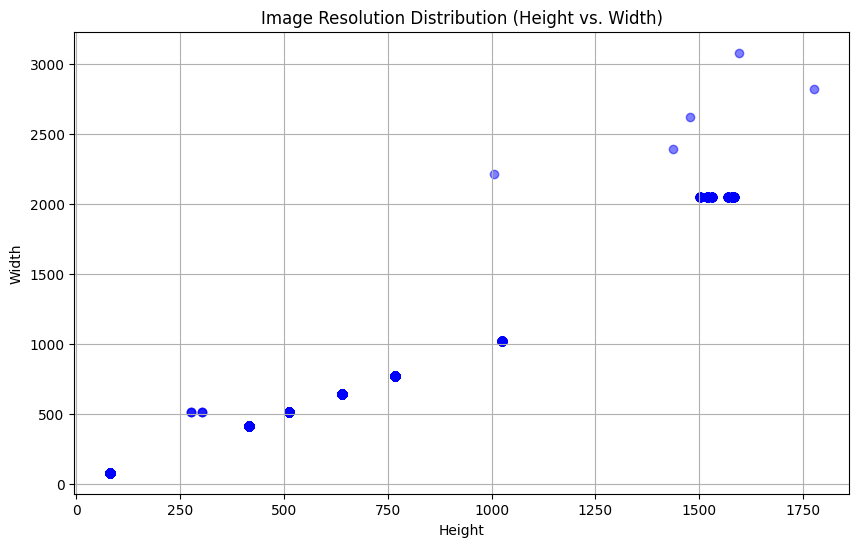

In [11]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Define the dataset directory (replace with the actual path to your dataset)
dataset_dir = "/content/dataset/ships-aerial-images/train/images"

# List to store the resolutions (height, width)
resolutions = []

# Loop through all images in the dataset directory
for img_file in os.listdir(dataset_dir):
    img_path = os.path.join(dataset_dir, img_file)

    # Read the image in full color (BGR by default)
    img = cv2.imread(img_path)

    # Check if the image is loaded successfully
    if img is not None:
        height, width, _ = img.shape
        resolutions.append((height, width))

# Convert resolutions to a numpy array for easier indexing
resolutions = np.array(resolutions)

# Create a scatter plot for Image Resolution Distribution (Height vs. Width)
plt.figure(figsize=(10, 6))
plt.scatter(resolutions[:, 0], resolutions[:, 1], alpha=0.5, color='blue')
plt.title('Image Resolution Distribution (Height vs. Width)')
plt.xlabel('Height')
plt.ylabel('Width')
plt.grid(True)
plt.show()



despite most of the images being 1:1 aspect ratio, their resoltuions differ. Hence, we will convert the resolutions of all our images to a standardized resoltuion

the non equal aspect ratios can also be seen from the resolution graph above, where there are some data points that width=/height

The scatter plot shows that most images fall between about 400 × 400 and 2 000 × 2 000 pixels especially square formats like 512×512, 768×768, and 1 024×1 024 while a few outliers extend down to 300 pixels on one side or up to 3 800 pixels on the other, resulting in both very tall and very wide rectangles. To handle this variability, we should pick a consistent target dimension , later on we will change it to 512 x 512 in preprocessing and then resize each image while preserving its aspect ratio, adding padding as needed so that all inputs become the same square shape without distortion.


### Image File Type Checking

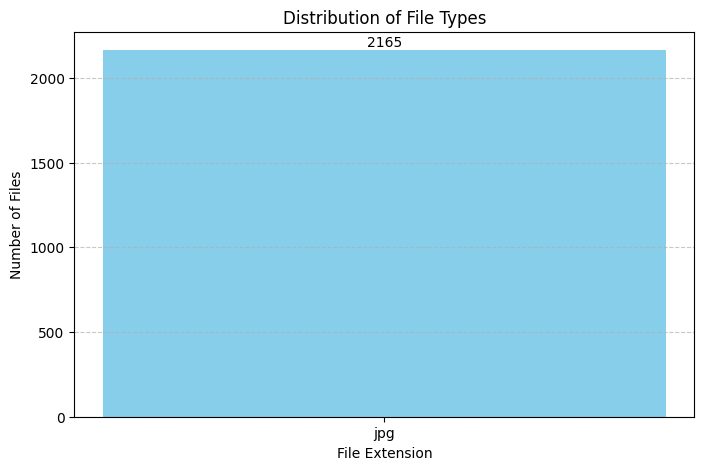

In [12]:
from collections import defaultdict
import os
import matplotlib.pyplot as plt

def plot_filetype_distribution(folder_path):
    file_types = defaultdict(int)

    for fname in os.listdir(folder_path):
        ext = fname.split('.')[-1].lower()
        file_types[ext] += 1

    # Plot
    labels = list(file_types.keys())
    counts = list(file_types.values())

    plt.figure(figsize=(8, 5))
    bars = plt.bar(labels, counts, color='skyblue')
    plt.xlabel("File Extension")
    plt.ylabel("Number of Files")
    plt.title("Distribution of File Types")
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    # Annotate bar values
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2.0, yval + 1, f'{yval}', ha='center', va='bottom')

    plt.show()

plot_filetype_distribution("/content/dataset/ships-aerial-images/valid/images")



from the plot of file type distributions, all our images are in jpg, which is fine. this means no changing of file type is required. (we checked both train and test images too, all are in jpg:)


### Validating & Looking Which Files Need To Resize

In [13]:
from PIL import Image
import os

def validate_images(folder_path, valid_extensions={'jpg', 'png'}, min_width=224, min_height=224):
    valid_count = 0
    invalid_count = 0
    resize_needed = 0

    for fname in os.listdir(folder_path):
        fpath = os.path.join(folder_path, fname)
        ext = fname.split('.')[-1].lower()

        # Skip non-image file types
        if ext not in valid_extensions:
            invalid_count += 1
            continue

        try:
            img = Image.open(fpath)
            width, height = img.size

            if width >= min_width and height >= min_height:
                valid_count += 1
            else:
                resize_needed += 1

        except Exception as e:
            print(f"Failed to read {fname}: {e}")
            invalid_count += 1

    print(f":) Valid images: {valid_count}")
    print(f":| Images requiring resize: {resize_needed}")
    print(f":( Invalid files: {invalid_count}")


In [14]:
print(f'Test results')
validate_images("/content/dataset/ships-aerial-images/test/images", min_width=224, min_height=224)
print(f'========================================================')
print(f'Train results')
validate_images("/content/dataset/ships-aerial-images/train/images", min_width=224, min_height=224)
print(f'========================================================')
print(f'Val results')
validate_images("/content/dataset/ships-aerial-images/valid/images", min_width=224, min_height=224)

Test results
:) Valid images: 1506
:| Images requiring resize: 67
:( Invalid files: 0
Train results
:) Valid images: 9235
:| Images requiring resize: 462
:( Invalid files: 0
Val results
:) Valid images: 2034
:| Images requiring resize: 131
:( Invalid files: 0


here we created a simple function to count th enumber of valid images per set, as well as the number of invalid images.


## EDA For Labels

similarly to the images, we're going to conduct eda on the bounding boxes of each image.

for bounding boxes, we're going to check the aspect ratios, resolution and frequency of bounding boxes for each image

### Distribution Of Bounding Box per splits

In [15]:
base_dir = "/content/dataset/ships-aerial-images"
splits = ["train", "valid", "test"]

records = []
for split in splits:
    label_dir = os.path.join(base_dir, split, "labels")
    for label_file in glob.glob(os.path.join(label_dir, '*.txt')):
        with open(label_file, 'r') as f:
            lines = [l for l in f if l.strip()]
        box_count = len(lines)
        records.append({
            "split": split,
            "boxes_in_image": box_count
        })

df_counts = pd.DataFrame(records)


In [16]:
df_counts.head(10)


,split,boxes_in_image
0,train,3
1,train,1
2,train,1
3,train,11
4,train,1
5,train,1
6,train,1
7,train,1
8,train,6
9,train,4


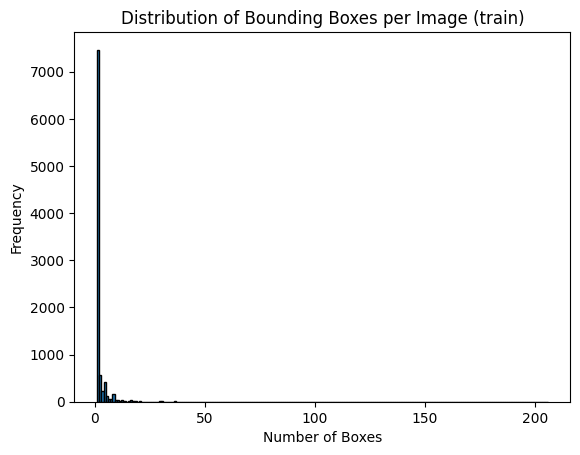

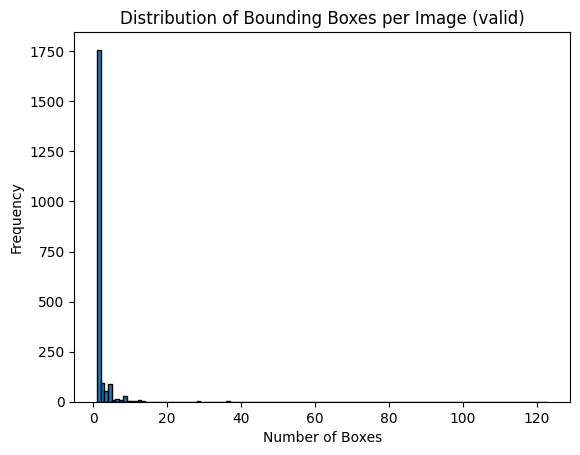

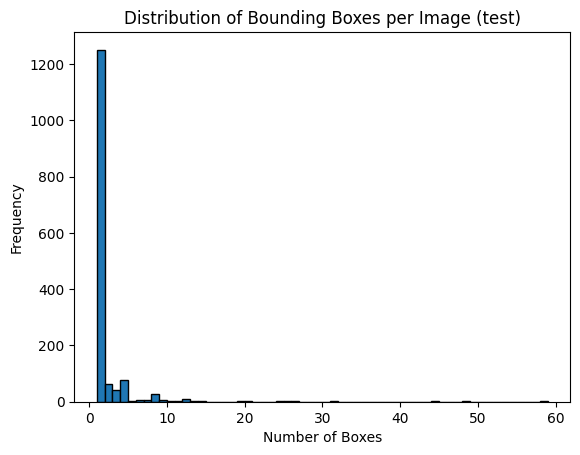

        count      mean       std  min  25%  50%  75%    max
split                                                       
test   1573.0  1.825811  3.339968  0.0  1.0  1.0  1.0   58.0
train  9697.0  2.006394  5.445155  0.0  1.0  1.0  1.0  205.0
valid  2165.0  1.718245  3.879786  0.0  1.0  1.0  1.0  122.0


In [17]:
for split in splits:
    counts = df_counts[df_counts["split"] == split]["boxes_in_image"]
    plt.figure()
    plt.hist(counts, bins=range(1, counts.max()+2), edgecolor='black')
    plt.title(f"Distribution of Bounding Boxes per Image ({split})")
    plt.xlabel("Number of Boxes")
    plt.ylabel("Frequency")
    plt.show()

summary = df_counts.groupby("split")["boxes_in_image"].describe()
print(summary)


## Bounding Box Distribution Frequency Analysis

From the “Distribution of Bounding Boxes per Image” histograms for each split (train, validation, test), we observe:

1. Most images contain very few boxes
In all splits, the peak frequency is at 1–5 boxes per image. In other words, the majority of images have only one or two ships labeled.
2. There is a long tail of images with many boxes
Although relatively rare, some images have dozens or even hundreds of bounding boxes. This creates a strongly right-skewed distribution: most images are “simple” (few boxes), but a small number are “dense” (many boxes).
3. Possible images with zero boxes (not shown in the label plots)
We plotted only those label files that actually exist, but it’s worth verifying whether any images have no corresponding label file at all (zero boxes). These “all-background” images need special handling.

Preprocessing methods for later

First, we will validate and clean every label file to ensure consistency. Each .txt file will be checked to confirm that its normalized YOLO coordinates lie within the [0, 1] range and that any absolute-pixel annotations (if present) do not exceed the source image’s width and height. We will convert all normalized boxes into absolute-pixel format (xmin, ymin, xmax, ymax) based on each image’s original dimensions. Any image without a corresponding label file (i.e., zero boxes) will be inspected, and we will decide whether to keep it as a pure-background example or remove it entirely so the model only trains on images that contain at least one ship.

Next, we will address the highly skewed “boxes per image” distribution. Images containing an unusually large number of bounding boxes (for example, more than 50) will be treated as outliers: we will either split those images into smaller patches or cap the number of boxes per image to prevent GPU memory blowup and overly large loss values. After handling outliers, every image will be resized (or letterbox-padded) to a fixed input size such as 512×512, and bounding boxes will be scaled accordingly. Finally, we will apply targeted data augmentations—standard flips, rotations, and color jitters for images with only a few boxes, and additional random crops or copy-paste augmentations for dense scenes—so that the model sees a balanced variety of images with varying object counts.





# Distribution Boxplot Bounding Box  

<ipython-input-18-1ed171488f3d>:10: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(boxplot_data, labels=splits, showfliers=True)


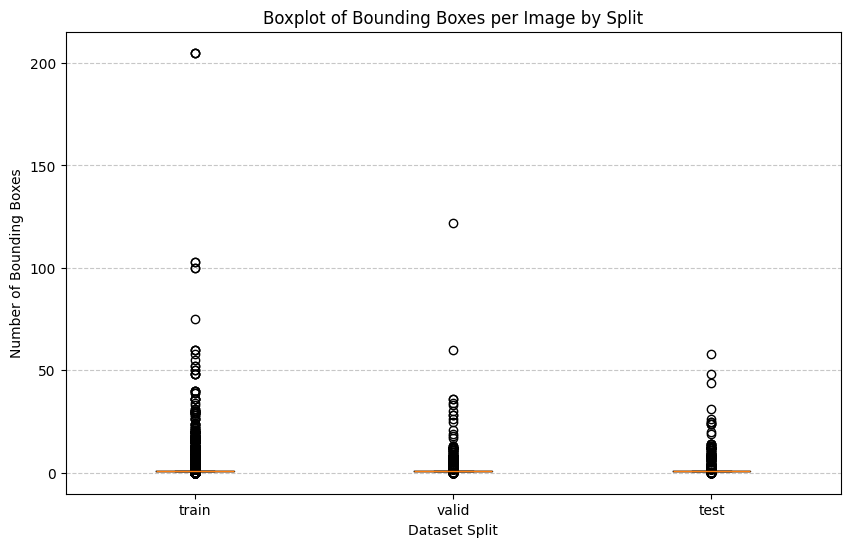

In [18]:
if df_counts.empty:
  pass
else:
    boxplot_data = [
        df_counts[df_counts["split"] == s]["boxes_in_image"]
        for s in splits
    ]

    plt.figure(figsize=(10, 6))
    plt.boxplot(boxplot_data, labels=splits, showfliers=True)
    plt.title("Boxplot of Bounding Boxes per Image by Split")
    plt.xlabel("Dataset Split")
    plt.ylabel("Number of Bounding Boxes")
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.show()

Handling The outliers ?

So later in preprocessing, we’ll first inspect each image’s annotation count and normalize the coordinate formats (e.g., convert all boxes to [x_min, y_min, x_max, y_max] relative to the resized image dimensions). Next, for images with extremely high box counts (e.g., >50 annotations), we’ll apply a cap or tiling strategy either clustering densely packed regions into sub-images or sampling a fixed maximum of boxes per crop to avoid memory overload. We’ll also pad or truncate low‐annotation images so that each training batch has a roughly uniform distribution of box counts, ensuring the model sees both “sparse” and “dense” examples. Finally, we’ll apply standard augmentations (random flips, scaling, color jitter) while preserving bounding‐box alignment, and compute class‐balanced weights if some object types appear primarily in high‐density scenes. This way, our network is trained on consistently formatted inputs that represent the full spectrum of object‐counts without being skewed by the rare extreme cases.

### Visualisasi Resolusi (Height & Width Bounding Box)

In [19]:
import os
import glob
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

train_images  = "/content/dataset/ships-aerial-images/train/images"
train_labels  = "/content/dataset/ships-aerial-images/train/labels"
test_images   = "/content/dataset/ships-aerial-images/test/images"
test_labels   = "/content/dataset/ships-aerial-images/test/labels"
val_images    = "/content/dataset/ships-aerial-images/valid/images"
val_labels    = "/content/dataset/ships-aerial-images/valid/labels"

def compute_image_metrics(image_dir, label_dir):
    mean_widths  = []
    mean_heights = []
    mean_areas   = []
    aspect_ratios = []

    for lbl_path in glob.glob(os.path.join(label_dir, "*.txt")):
        basename = os.path.basename(lbl_path).replace(".txt", "")
        img_path = None
        for ext in [".png", ".jpg", ".jpeg", ".bmp"]:
            cand = os.path.join(image_dir, basename + ext)
            if os.path.isfile(cand):
                img_path = cand
                break
        if img_path is None:
            continue

        with Image.open(img_path) as img:
            img_w, img_h = img.size

        widths  = []
        heights = []
        areas   = []
        ars     = []

        with open(lbl_path, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) < 5:
                    continue
                w_norm = float(parts[3])
                h_norm = float(parts[4])

                bbox_w = w_norm * img_w
                bbox_h = h_norm * img_h
                bbox_area = bbox_w * bbox_h
                ar = bbox_w / bbox_h if bbox_h > 0 else 0

                widths.append(bbox_w)
                heights.append(bbox_h)
                areas.append(bbox_area)
                ars.append(ar)

        if not widths:
            continue

        mean_widths.append(np.mean(widths))
        mean_heights.append(np.mean(heights))
        mean_areas.append(np.mean(areas))
        aspect_ratios.extend(ars)

    return (
        np.array(mean_widths),
        np.array(mean_heights),
        np.array(mean_areas),
        np.array(aspect_ratios),
    )


train_mw, train_mh, train_ma, train_ar = compute_image_metrics(train_images, train_labels)
test_mw,  test_mh,  test_ma,  test_ar  = compute_image_metrics(test_images,  test_labels)
val_mw,   val_mh,   val_ma,   val_ar   = compute_image_metrics(val_images,   val_labels)

metrics = {
    "Train": (train_mw, train_mh, train_ma, train_ar, "tab:blue"),
    "Test":  (test_mw,  test_mh,  test_ma,  test_ar,  "tab:orange"),
    "Valid": (val_mw,   val_mh,   val_ma,   val_ar,   "tab:green"),
}

# Distribution MEAN WIDTH vs. MEAN HEIGHT

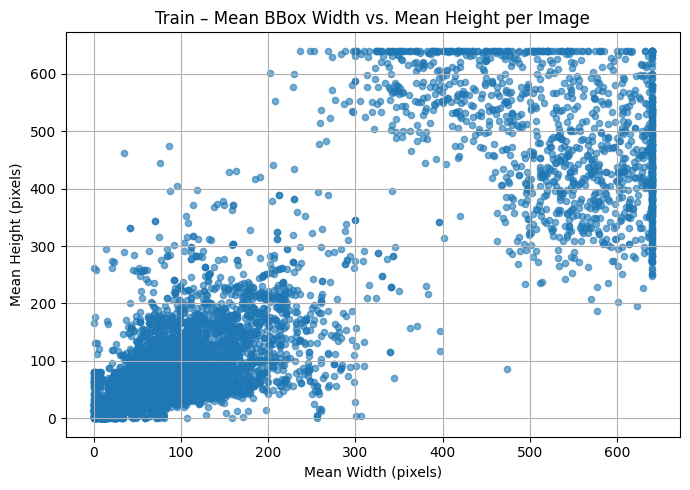

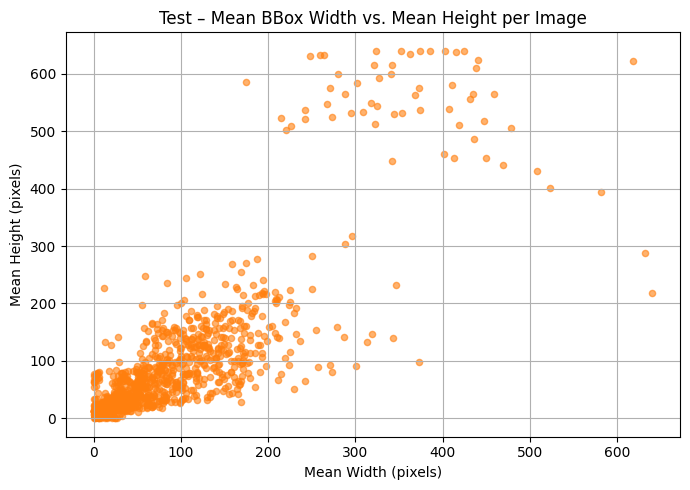

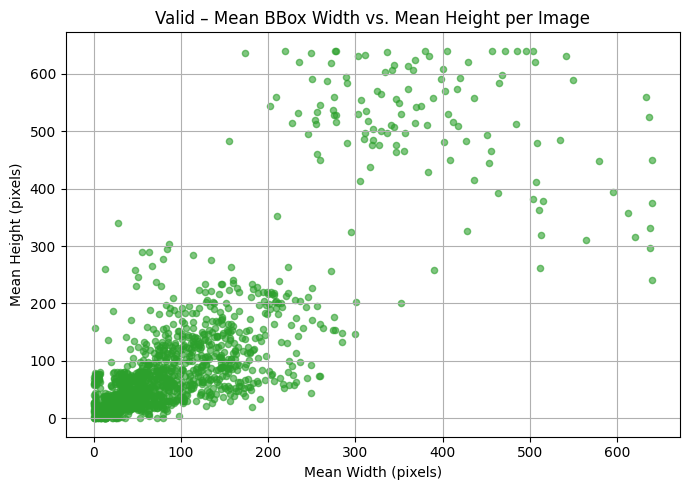

In [20]:
for split_name, (mw, mh, ma, ar, color) in metrics.items():
    plt.figure(figsize=(7,5))
    plt.scatter(mw, mh, s=20, alpha=0.6, color=color)
    plt.title(f"{split_name} – Mean BBox Width vs. Mean Height per Image")
    plt.xlabel("Mean Width (pixels)")
    plt.ylabel("Mean Height (pixels)")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

here we plot the distribution of both width and height of bounding boxes within images. as we can see the width and height varies heavily. indicating the the bounding boxes for each image differs from one another. this could be due to the presenece of different ships, different zooms of the images, etc. Anyways we can see that's theres a lot of bounding box tht has low pixel and thus this could be a threat later for our training and testing model so we gonna drop it later. The reason is Low‐pixel count bounding boxes are problematic because they contain very little visual information just a few pixels may represent an entire object making it difficult for a detector to learn distinguishing features such as shape, texture, and edges; as a result, the model may struggle to localize or classify these tiny boxes accurately, leading to higher false positives or negatives. Moreover, extremely small boxes often get swamped by background noise or compression artifacts, their labels may be less reliable, and they can skew the training distribution by forcing the network to allocate capacity to examples that yield little meaningful signal


# Distribution Mean Bounding Box Area

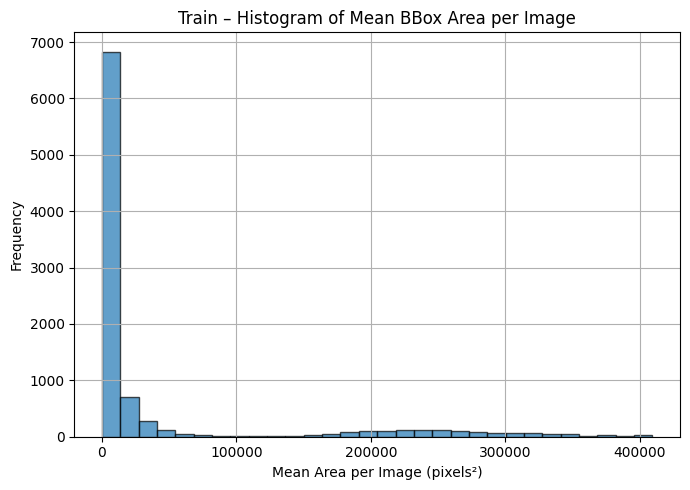

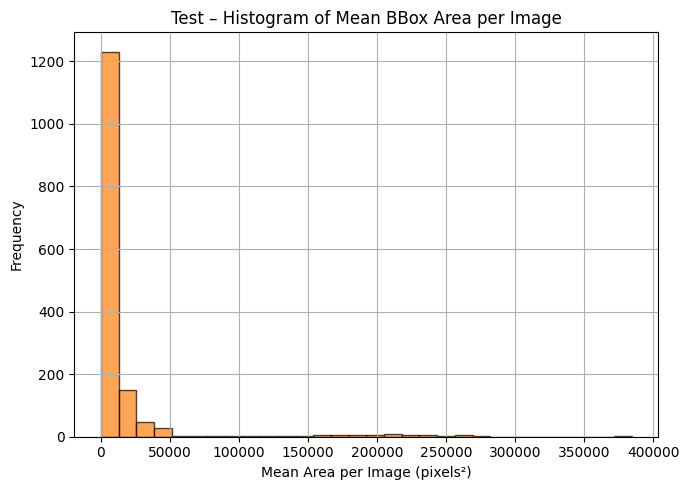

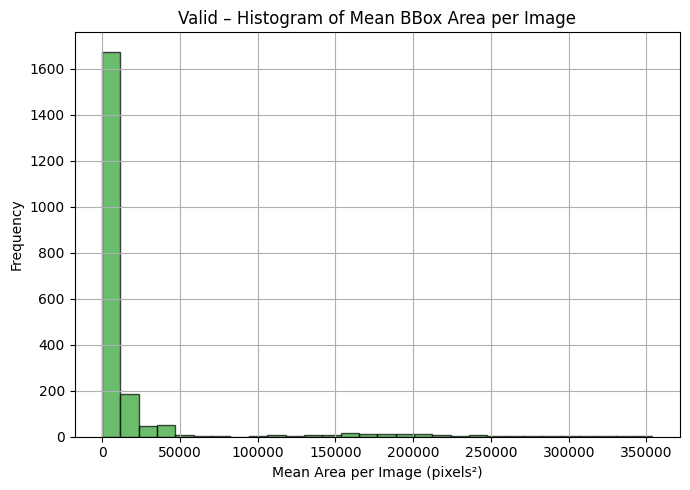

In [21]:
for split_name, (mw, mh, ma, ar, color) in metrics.items():
    plt.figure(figsize=(7,5))
    plt.hist(ma, bins=30, alpha=0.7, color=color, edgecolor="black")
    plt.title(f"{split_name} – Histogram of Mean BBox Area per Image")
    plt.xlabel("Mean Area per Image (pixels²)")
    plt.ylabel("Frequency")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

### Visualisasi Ratio Bounding Box

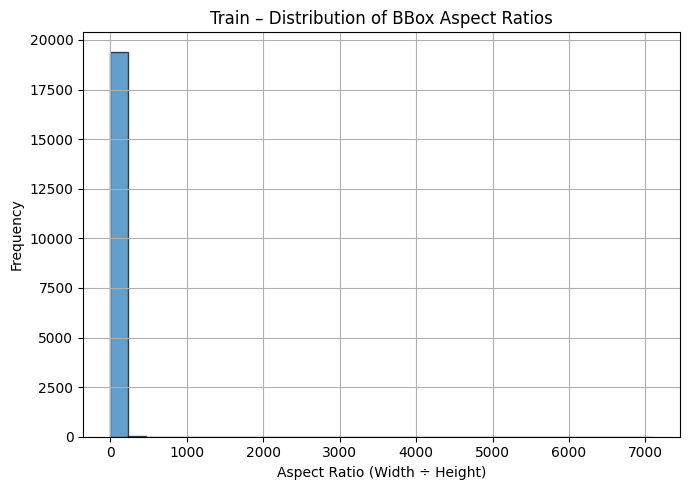

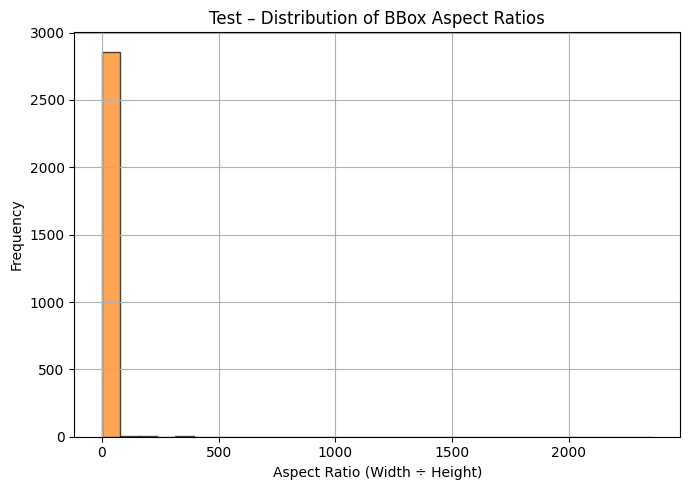

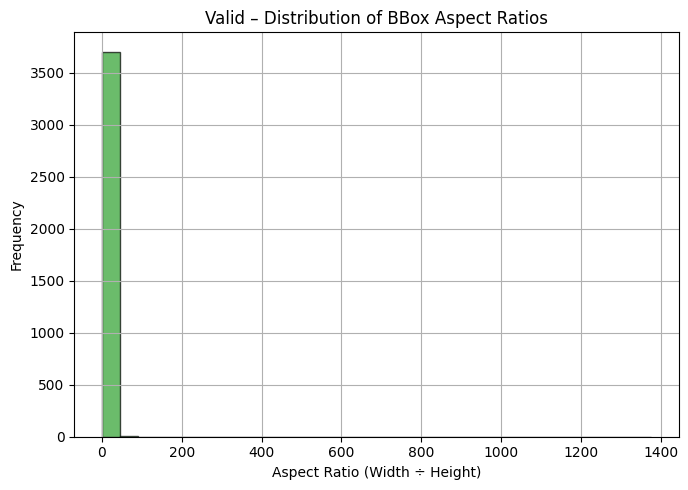

In [22]:
for split_name, (mw, mh, ma, ar, color) in metrics.items():
    plt.figure(figsize=(7,5))
    plt.hist(ar, bins=30, alpha=0.7, color=color, edgecolor="black")
    plt.title(f"{split_name} – Distribution of BBox Aspect Ratios")
    plt.xlabel("Aspect Ratio (Width ÷ Height)")
    plt.ylabel("Frequency")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

and due to the variance of width x height of the bounding boxes, we get varying aspect ratios too

Bounding boxes with aspect ratios that aren’t 1:1 can also pose challenges because most detectors (especially those using fixed‐shape anchors) often assume roughly square or only mildly rectangular regions. Soo later in preprocessing we will resize the bounding box to have an aspect ratio of 1:1

### Distribusi Jumlah Bounding Box Per Image

# Preprocessing The Data

In [23]:
TARGET_SIZE = (512, 512)
MIN_BOX_PIXELS = 2
MAX_BOXES_PER_IMAGE = 50

train_images = "/content/dataset/ships-aerial-images/train/images"
train_labels = "/content/dataset/ships-aerial-images/train/labels"

test_images  = "/content/dataset/ships-aerial-images/test/images"
test_labels  = "/content/dataset/ships-aerial-images/test/labels"

val_images   = "/content/dataset/ships-aerial-images/valid/images"
val_labels   = "/content/dataset/ships-aerial-images/valid/labels"

preproc_base = "/content/dataset/ships-aerial-images/preprocessed"

splits = {
    "train": (train_images, train_labels),
    "test":  (test_images,  test_labels),
    "valid": (val_images,   val_labels)
}

processed_counts = {}
total_kept = 0

for split, (input_img_dir, input_lbl_dir) in splits.items():
    out_img_dir = os.path.join(preproc_base, split, "images")
    out_lbl_dir = os.path.join(preproc_base, split, "labels")
    os.makedirs(out_img_dir, exist_ok=True)
    os.makedirs(out_lbl_dir, exist_ok=True)

    kept_count = 0

    for lbl_path in glob.glob(os.path.join(input_lbl_dir, "*.txt")):
        base = os.path.basename(lbl_path).rsplit(".", 1)[0]
        img_path = None
        for ext in [".png", ".jpg", ".jpeg", ".bmp"]:
            candidate = os.path.join(input_img_dir, base + ext)
            if os.path.isfile(candidate):
                img_path = candidate
                break
        if img_path is None:
            continue

        with open(lbl_path, "r") as f:
            lines = [l.strip() for l in f if l.strip()]
        if len(lines) > MAX_BOXES_PER_IMAGE:
            continue

        with Image.open(img_path) as img:
            orig_w, orig_h = img.size
            resized = img.resize(TARGET_SIZE)
        scale_x = TARGET_SIZE[0] / orig_w
        scale_y = TARGET_SIZE[1] / orig_h

        new_lines = []
        drop_image = False

        for line in lines:
            parts = line.split()
            if len(parts) < 5:
                drop_image = True
                break
            cls = parts[0]
            x_c_norm = float(parts[1])
            y_c_norm = float(parts[2])
            w_norm   = float(parts[3])
            h_norm   = float(parts[4])

            w_resized = w_norm * orig_w * scale_x
            h_resized = h_norm * orig_h * scale_y
            side_resized = max(w_resized, h_resized)

            if side_resized <= MIN_BOX_PIXELS:
                drop_image = True
                break

            x_c_resized = x_c_norm * TARGET_SIZE[0]
            y_c_resized = y_c_norm * TARGET_SIZE[1]
            x_min = x_c_resized - side_resized / 2
            y_min = y_c_resized - side_resized / 2

            if x_min < 0:
                x_min = 0
            if y_min < 0:
                y_min = 0
            if x_min + side_resized > TARGET_SIZE[0]:
                x_min = TARGET_SIZE[0] - side_resized
            if y_min + side_resized > TARGET_SIZE[1]:
                y_min = TARGET_SIZE[1] - side_resized

            x_c_new = x_min + side_resized / 2
            y_c_new = y_min + side_resized / 2

            new_xc_norm = x_c_new / TARGET_SIZE[0]
            new_yc_norm = y_c_new / TARGET_SIZE[1]
            new_w_norm  = side_resized / TARGET_SIZE[0]
            new_h_norm  = side_resized / TARGET_SIZE[1]

            new_lines.append(f"{cls} {new_xc_norm:.6f} {new_yc_norm:.6f} {new_w_norm:.6f} {new_h_norm:.6f}\n")

        if drop_image:
            continue

        out_img_path = os.path.join(out_img_dir, os.path.basename(img_path))
        resized.save(out_img_path)

        out_lbl_path = os.path.join(out_lbl_dir, os.path.basename(lbl_path))
        with open(out_lbl_path, "w") as fw:
            fw.writelines(new_lines)

        kept_count += 1

    processed_counts[split] = kept_count
    total_kept += kept_count

for split, count in processed_counts.items():
    pct = (count / total_kept * 100) if total_kept else 0
    print(f"{split}: {count} images ({pct:.2f}%)")


train: 9453 images (72.35%)
test: 1501 images (11.49%)
valid: 2111 images (16.16%)


Preprocessing Steps:
In this preprocessing , every image is first checked for the number of bounding boxes (dropping any image with more than 50 boxes) and then opened to retrieve its original dimensions; each image is resized to 512×512 pixels, and its normalized bounding‐box coordinates (x_center, y_center, width, height) are converted to absolute pixel values, forced into square boxes (using the larger side), clamped to stay within the 512×512 frame, and normalized back to [0,1]—any image whose square box would be smaller than 2×2 pixels is discarded. After processing all splits, you end up with 9,453 images (72.35 %) in the training set, 1,501 images (11.49 %) in the test set, and 2,111 images (16.16 %) in the validation set; while it’s more common to see a smaller validation set compared to testing, having a larger validation set is not inherently problematic as long as the test set remains representative and sufficiently large to evaluate final performance.



# Building the Model

### Convert to Yolo Format

after preprocessing the images and bounding boxes as described, the dataset is converted into the YOLO format.

n the YOLO format, each image has a corresponding .txt file (with the same  filename) placed in the labels folder matching the image split (train, val, or test). Each line in the .txt file represents one bounding box. in the format of class id xcenter ycenter width height.

when in YOLO format, each coordinate is normalized relative to the img size (divided by 512), this is done to allow faster loading and training times

In [24]:
import os
import glob
import shutil
import yaml

# Paths for your preprocessed data
PREPROC_BASE = "/content/dataset/ships-aerial-images/preprocessed"
# Desired output root for YOLOv8
YOLOV8_ROOT = "/content/dataset/ships-aerial-yolov8"

# Splits and corresponding subfolders
splits = ["train", "valid", "test"]

# 1) Create YOLOv8-style directory tree:
for split in splits:
    os.makedirs(os.path.join(YOLOV8_ROOT, "images", split), exist_ok=True)
    os.makedirs(os.path.join(YOLOV8_ROOT, "labels", split), exist_ok=True)

# 2) Copy images and label files from preprocessed to YOLOv8 folders
for split in splits:
    src_img_dir = os.path.join(PREPROC_BASE, split, "images")
    src_lbl_dir = os.path.join(PREPROC_BASE, split, "labels")
    dst_img_dir = os.path.join(YOLOV8_ROOT, "images", split)
    dst_lbl_dir = os.path.join(YOLOV8_ROOT, "labels", split)

    # Copy each image file (png/jpg/jpeg/bmp)
    for ext in ("*.png", "*.jpg", "*.jpeg"):
        for img_path in glob.glob(os.path.join(src_img_dir, ext)):
            shutil.copy(img_path, dst_img_dir)

    # Copy each label .txt
    for lbl_path in glob.glob(os.path.join(src_lbl_dir, "*.txt")):
        shutil.copy(lbl_path, dst_lbl_dir)

# 3) Collect all class IDs from labels to determine number of classes
all_classes = set()
for split in splits:
    lbl_folder = os.path.join(PREPROC_BASE, split, "labels")
    for lbl_file in glob.glob(os.path.join(lbl_folder, "*.txt")):
        with open(lbl_file, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) >= 1:
                    all_classes.add(int(parts[0]))
if not all_classes:
    raise RuntimeError("No labels found in any split.")

num_classes = max(all_classes) + 1

# 4) Build a placeholder 'names' list—for example: ["class0", "class1", ...]
#    You can replace these with actual class names if known.
names = [f"class{idx}" for idx in range(num_classes)]

# 5) Write data.yaml for YOLOv8
data_yaml = {
    "path": YOLOV8_ROOT,
    "train": "images/train",
    "val":   "images/valid",
    "test":  "images/test",
    "nc":    num_classes,
    "names": names
}

with open(os.path.join(YOLOV8_ROOT, "data.yaml"), "w") as fw:
    yaml.dump(data_yaml, fw, default_flow_style=False)

print(f"YOLOv8 dataset structure created at: {YOLOV8_ROOT}")
print(f" - Classes detected: {num_classes}")
print(f" - data.yaml written with splits: train, val, test")

YOLOv8 dataset structure created at: /content/dataset/ships-aerial-yolov8
 - Classes detected: 1
 - data.yaml written with splits: train, val, test


### Train Model

after prepping our data, we're going to start training our model. we start with initial epochs of 10 and 4 images per batch. we will be using the yolov8s architecture, a middleground yolo model for both performance and speed. the confidence parameter we use will be 0.25, meaning that boxes witha confidence level of less than 25% will be filtered out.

In [25]:
model = YOLO('yolov8s.pt')

model.train(
    data='/content/dataset/ships-aerial-yolov8/data.yaml',  # Path to your YAML file
    epochs=10,
    imgsz=512,
    seed=42,
    batch=4,
    workers=4,
    conf=0.25
)

100%|██████████| 21.5M/21.5M [00:00<00:00, 248MB/s]


Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=0.25, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset/ships-aerial-yolov8/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=512, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose

100%|██████████| 755k/755k [00:00<00:00, 24.1MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

 15                  -1  1    148224  ultralytics.nn.modules.block.C2f             [384, 128, 1]                 
 16                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
 17            [-1, 12]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 18                  -1  1    493056  ultralytics.nn.modules.block.C2f             [384, 256, 1]                 
 19                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
 20             [-1, 9]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 21                  -1  1   1969152  ultralytics.nn.modules.block.C2f             [768, 512, 1]                 
 22        [15, 18, 21]  1   2116435  ultralytics.nn.modules.head.Detect           [1, [128, 256, 512]]          
Model summary: 129 layers, 11,135,987 parameters, 11,135,971 gradients, 28.6 GFLOPs

Tra

100%|██████████| 5.35M/5.35M [00:00<00:00, 98.5MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 529.5±214.7 MB/s, size: 13.2 KB)


train: Scanning /content/dataset/ships-aerial-yolov8/labels/train... 9453 images, 351 backgrounds, 0 corrupt: 100%|██████████| 9453/9453 [00:04<00:00, 2323.80it/s]


train: New cache created: /content/dataset/ships-aerial-yolov8/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 565.2±305.0 MB/s, size: 28.1 KB)


val: Scanning /content/dataset/ships-aerial-yolov8/labels/valid... 2111 images, 68 backgrounds, 0 corrupt: 100%|██████████| 2111/2111 [00:00<00:00, 2170.48it/s]

val: New cache created: /content/dataset/ships-aerial-yolov8/labels/valid.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10     0.836G      1.649      2.596      1.657          1        512: 100%|██████████| 2364/2364 [04:05<00:00,  9.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:18<00:00, 14.64it/s]

                   all       2111       3172      0.485      0.277      0.396       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         1G      1.522      1.633      1.565          1        512: 100%|██████████| 2364/2364 [03:53<00:00, 10.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:17<00:00, 15.22it/s]

                   all       2111       3172      0.562       0.26      0.406      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      1.04G      1.427      1.502      1.484          3        512: 100%|██████████| 2364/2364 [03:48<00:00, 10.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:17<00:00, 15.51it/s]

                   all       2111       3172      0.708      0.306      0.529      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      1.08G       1.36      1.383      1.432          1        512: 100%|██████████| 2364/2364 [03:47<00:00, 10.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:16<00:00, 15.63it/s]

                   all       2111       3172      0.721      0.313       0.54      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      1.11G      1.292      1.271      1.384          1        512: 100%|██████████| 2364/2364 [03:46<00:00, 10.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:17<00:00, 15.08it/s]

                   all       2111       3172      0.648      0.325      0.515      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      1.21G      1.237      1.187      1.347          5        512: 100%|██████████| 2364/2364 [03:46<00:00, 10.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:17<00:00, 14.97it/s]

                   all       2111       3172      0.758      0.329      0.562      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      1.24G      1.198      1.112      1.314          1        512: 100%|██████████| 2364/2364 [03:49<00:00, 10.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:17<00:00, 14.81it/s]

                   all       2111       3172       0.76      0.333      0.565      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      1.29G      1.154      1.068      1.276          1        512: 100%|██████████| 2364/2364 [03:49<00:00, 10.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:17<00:00, 15.21it/s]

                   all       2111       3172      0.818      0.333      0.587      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      1.39G      1.101      1.013       1.24          4        512: 100%|██████████| 2364/2364 [03:50<00:00, 10.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:17<00:00, 14.78it/s]

                   all       2111       3172      0.754      0.379      0.587      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      1.42G      1.075     0.9759      1.217          1        512: 100%|██████████| 2364/2364 [03:48<00:00, 10.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:17<00:00, 15.32it/s]

                   all       2111       3172      0.771      0.365      0.587      0.448



10 epochs completed in 0.691 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,125,971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:16<00:00, 16.34it/s]


                   all       2111       3172      0.771      0.365      0.587      0.448
Speed: 0.2ms preprocess, 3.0ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c88d12b4dd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

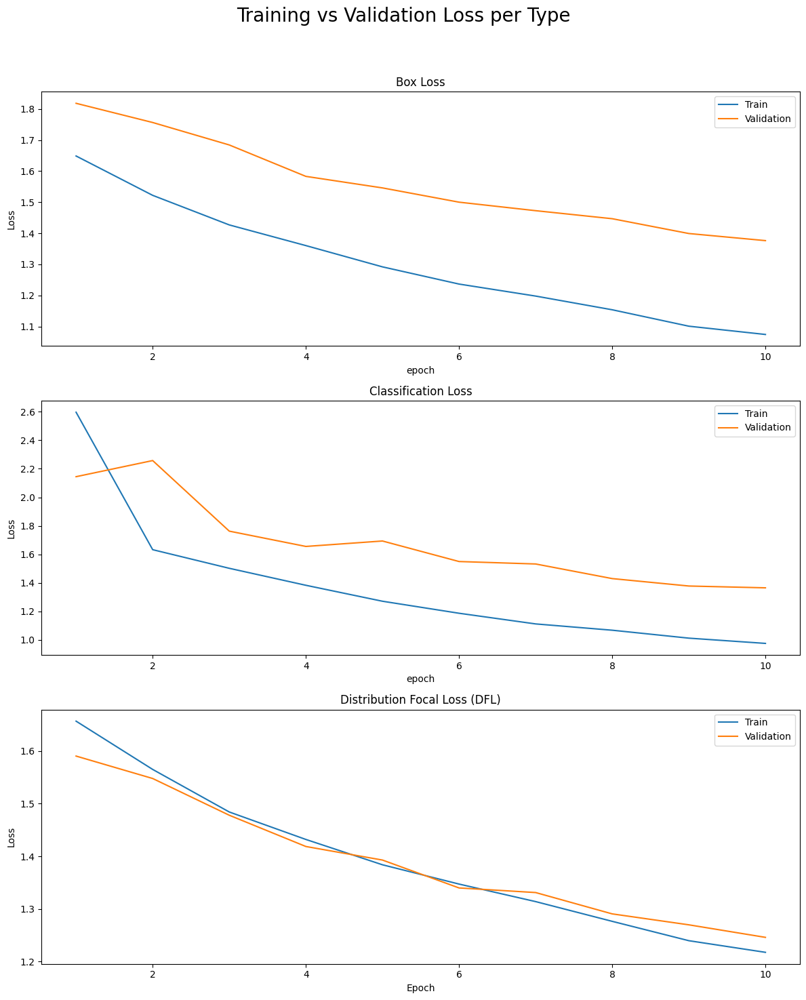


Final Loss Values at Epoch 10
Box Loss - Train: 1.0745, Validation: 1.3764
Classification Loss - Train: 0.9759, Validation: 1.3654
DFL Loss - Train: 1.2175, Validation: 1.2459


In [26]:
# Load and clean CSV
df = pd.read_csv('/content/runs/detect/train/results.csv')
df.columns = df.columns.str.strip()

# Create subplots: one row per loss type
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(12, 15))

# 1. Box Loss
sns.lineplot(x='epoch', y='train/box_loss', data=df, label='Train', ax=axs[0])
sns.lineplot(x='epoch', y='val/box_loss', data=df, label='Validation', ax=axs[0])
axs[0].set_title('Box Loss')
axs[0].set_ylabel('Loss')
axs[0].legend()

# 2. Classification Loss
sns.lineplot(x='epoch', y='train/cls_loss', data=df, label='Train', ax=axs[1])
sns.lineplot(x='epoch', y='val/cls_loss', data=df, label='Validation', ax=axs[1])
axs[1].set_title('Classification Loss')
axs[1].set_ylabel('Loss')
axs[1].legend()

# 3. DFL Loss
sns.lineplot(x='epoch', y='train/dfl_loss', data=df, label='Train', ax=axs[2])
sns.lineplot(x='epoch', y='val/dfl_loss', data=df, label='Validation', ax=axs[2])
axs[2].set_title('Distribution Focal Loss (DFL)')
axs[2].set_xlabel('Epoch')
axs[2].set_ylabel('Loss')
axs[2].legend()

# Add a common suptitle
plt.suptitle('Training vs Validation Loss per Type', fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.95])  # make space for suptitle

plt.show()

last_epoch = df['epoch'].max()
final_vals = df[df['epoch'] == last_epoch]

print("\nFinal Loss Values at Epoch", last_epoch)
print(f"Box Loss - Train: {final_vals['train/box_loss'].values[0]:.4f}, Validation: {final_vals['val/box_loss'].values[0]:.4f}")
print(f"Classification Loss - Train: {final_vals['train/cls_loss'].values[0]:.4f}, Validation: {final_vals['val/cls_loss'].values[0]:.4f}")
print(f"DFL Loss - Train: {final_vals['train/dfl_loss'].values[0]:.4f}, Validation: {final_vals['val/dfl_loss'].values[0]:.4f}")


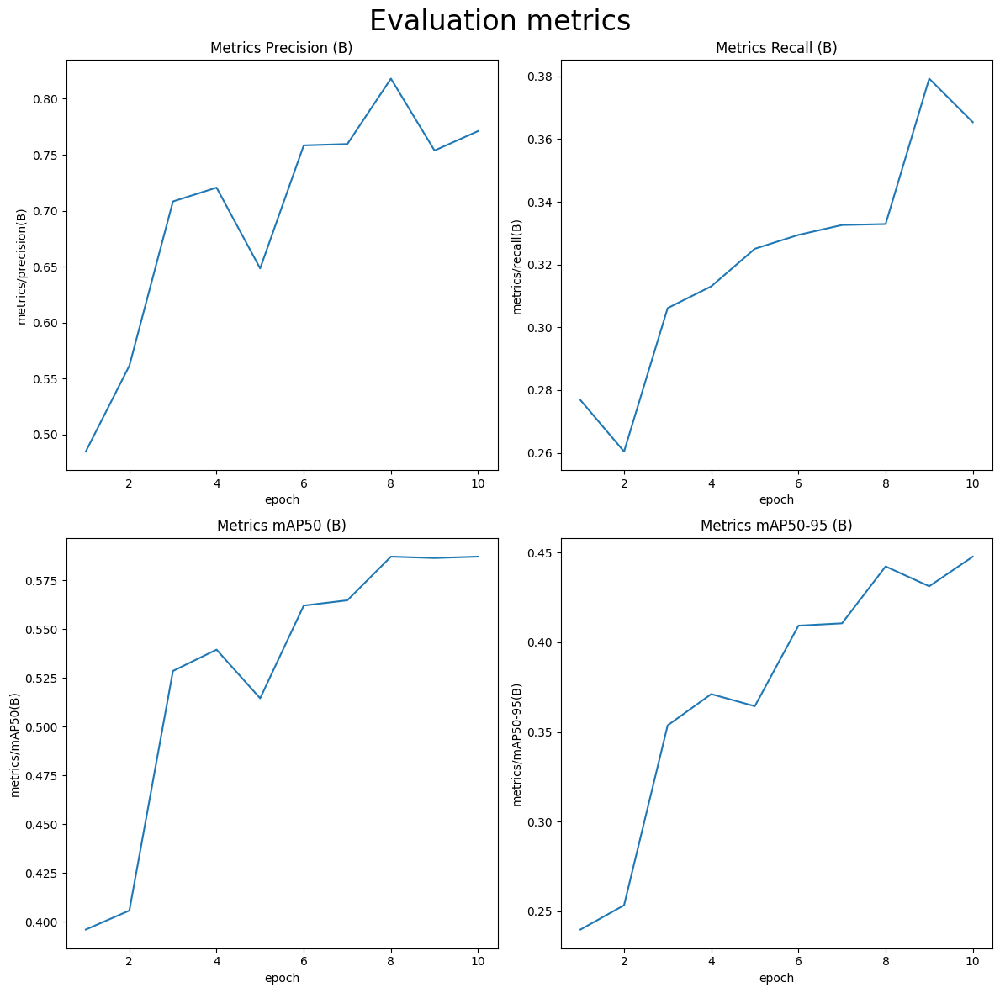

In [27]:
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 12))


sns.lineplot(x='epoch', y='metrics/precision(B)', data=df, ax=axs[0,0])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=df, ax=axs[0,1])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=df, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=df, ax=axs[1,1])

axs[0,0].set(title='Metrics Precision (B)')
axs[0,1].set(title='Metrics Recall (B)')
axs[1,0].set(title='Metrics mAP50 (B)')
axs[1,1].set(title='Metrics mAP50-95 (B)')

# add suptitle and subheader
plt.suptitle('Evaluation metrics', fontsize=24)

# adjust top margin to make space for suptitle
plt.subplots_adjust(top=0.8)

# adjust spacing between subplots
plt.tight_layout()

plt.show()


from the loss curves of both train and val, we can see that they both decrease over epochs. however the graphs havent plateued, meaning there could potentially be improvements if we were to increase the epochs for training in the future

for the 4 scoring metrics we used, recall, prec, map50 and map50:95. all metrics increased over epochs. however similar to the loss graphs, we think training over longer epochs may yield better results

## Training with yolov8m

now, we're going to use a different yolov8 framework, this time a model with a more complex framework. In yolov8m, the parameters are almost double in amount. hence this mo0del will take more time and resources to train.

we will train this model using the same training parameters as we did with the previous model

In [28]:
model2 = YOLO('yolov8m.pt')

model2.train(
    data='/content/dataset/ships-aerial-yolov8/data.yaml',  # Path to your YAML file
    epochs=10,
    imgsz=512,
    seed=42,
    batch=4,
    workers=4,
    conf=0.25
)

100%|██████████| 49.7M/49.7M [00:00<00:00, 163MB/s]


Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=0.25, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/dataset/ships-aerial-yolov8/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=512, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pos

train: Scanning /content/dataset/ships-aerial-yolov8/labels/train.cache... 9453 images, 351 backgrounds, 0 corrupt: 100%|██████████| 9453/9453 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 357.8±98.0 MB/s, size: 28.1 KB)


val: Scanning /content/dataset/ships-aerial-yolov8/labels/valid.cache... 2111 images, 68 backgrounds, 0 corrupt: 100%|██████████| 2111/2111 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      1.85G      1.736      2.109      1.828          1        512: 100%|██████████| 2364/2364 [05:20<00:00,  7.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:23<00:00, 11.40it/s]

                   all       2111       3172      0.432      0.191       0.29      0.161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.04G      1.593      1.814      1.704          1        512: 100%|██████████| 2364/2364 [05:05<00:00,  7.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:24<00:00, 10.91it/s]

                   all       2111       3172      0.508      0.255      0.382      0.241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.04G      1.462      1.604      1.581          3        512: 100%|██████████| 2364/2364 [05:09<00:00,  7.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:23<00:00, 11.46it/s]

                   all       2111       3172      0.682      0.272      0.496      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.08G      1.375      1.458      1.501          1        512: 100%|██████████| 2364/2364 [05:00<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:23<00:00, 11.23it/s]

                   all       2111       3172      0.762      0.292      0.539      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.22G      1.331      1.368      1.462          1        512: 100%|██████████| 2364/2364 [04:59<00:00,  7.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:22<00:00, 11.52it/s]


                   all       2111       3172      0.661      0.321      0.514      0.364

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.28G      1.258      1.264      1.416          5        512: 100%|██████████| 2364/2364 [05:00<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:23<00:00, 11.19it/s]

                   all       2111       3172      0.752      0.329      0.558      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.28G      1.212      1.163      1.386          1        512: 100%|██████████| 2364/2364 [05:02<00:00,  7.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:23<00:00, 11.14it/s]

                   all       2111       3172      0.765      0.333      0.566      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.28G      1.169      1.113      1.354          1        512: 100%|██████████| 2364/2364 [05:01<00:00,  7.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:23<00:00, 11.19it/s]

                   all       2111       3172      0.775      0.339      0.571      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      2.28G      1.126       1.06      1.317          4        512: 100%|██████████| 2364/2364 [05:01<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:23<00:00, 11.39it/s]

                   all       2111       3172      0.721      0.382      0.569      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.28G      1.093      1.007      1.289          1        512: 100%|██████████| 2364/2364 [05:00<00:00,  7.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:23<00:00, 11.22it/s]

                   all       2111       3172      0.729      0.375      0.573      0.424



10 epochs completed in 0.920 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 52.0MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 264/264 [00:21<00:00, 12.43it/s]


                   all       2111       3172      0.729      0.375      0.573      0.424
Speed: 0.2ms preprocess, 6.7ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c8940d14f10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

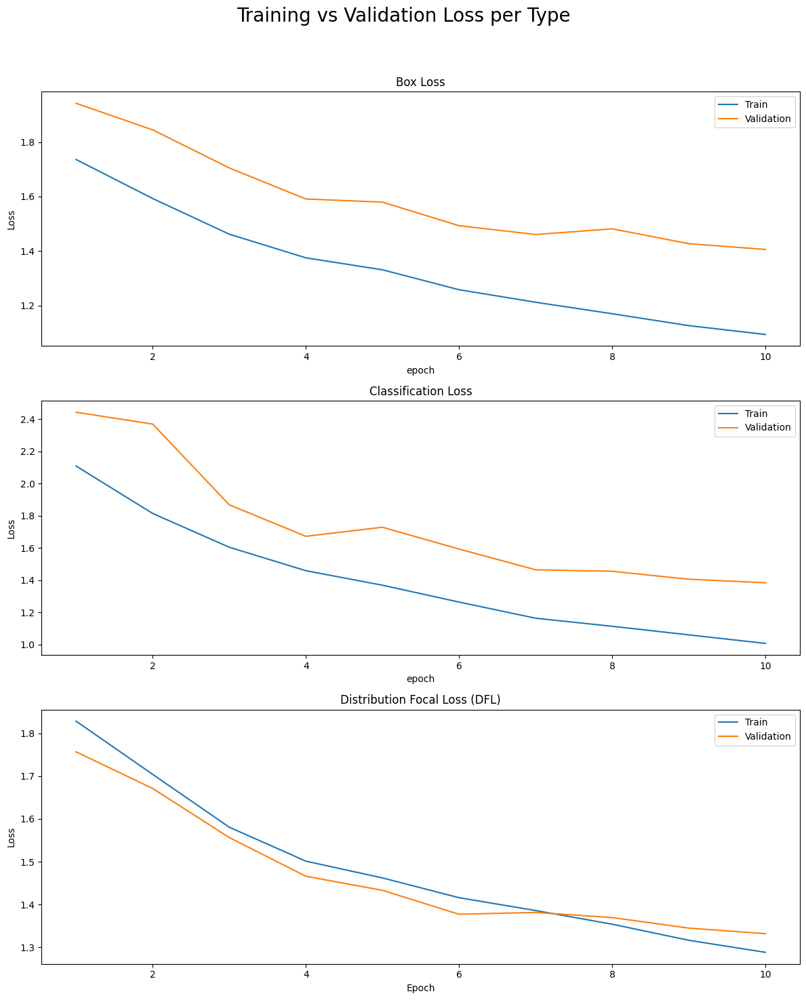


Final Loss Values at Epoch 10
Box Loss - Train: 1.0933, Validation: 1.4057
Classification Loss - Train: 1.0068, Validation: 1.3836
DFL Loss - Train: 1.2885, Validation: 1.3321


In [29]:
# Load and clean CSV
df = pd.read_csv('/content/runs/detect/train2/results.csv')
df.columns = df.columns.str.strip()

# Create subplots: one row per loss type
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(12, 15))

# 1. Box Loss
sns.lineplot(x='epoch', y='train/box_loss', data=df, label='Train', ax=axs[0])
sns.lineplot(x='epoch', y='val/box_loss', data=df, label='Validation', ax=axs[0])
axs[0].set_title('Box Loss')
axs[0].set_ylabel('Loss')
axs[0].legend()

# 2. Classification Loss
sns.lineplot(x='epoch', y='train/cls_loss', data=df, label='Train', ax=axs[1])
sns.lineplot(x='epoch', y='val/cls_loss', data=df, label='Validation', ax=axs[1])
axs[1].set_title('Classification Loss')
axs[1].set_ylabel('Loss')
axs[1].legend()

# 3. DFL Loss
sns.lineplot(x='epoch', y='train/dfl_loss', data=df, label='Train', ax=axs[2])
sns.lineplot(x='epoch', y='val/dfl_loss', data=df, label='Validation', ax=axs[2])
axs[2].set_title('Distribution Focal Loss (DFL)')
axs[2].set_xlabel('Epoch')
axs[2].set_ylabel('Loss')
axs[2].legend()

# Add a common suptitle
plt.suptitle('Training vs Validation Loss per Type', fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.95])  # make space for suptitle

plt.show()

last_epoch = df['epoch'].max()
final_vals = df[df['epoch'] == last_epoch]

print("\nFinal Loss Values at Epoch", last_epoch)
print(f"Box Loss - Train: {final_vals['train/box_loss'].values[0]:.4f}, Validation: {final_vals['val/box_loss'].values[0]:.4f}")
print(f"Classification Loss - Train: {final_vals['train/cls_loss'].values[0]:.4f}, Validation: {final_vals['val/cls_loss'].values[0]:.4f}")
print(f"DFL Loss - Train: {final_vals['train/dfl_loss'].values[0]:.4f}, Validation: {final_vals['val/dfl_loss'].values[0]:.4f}")


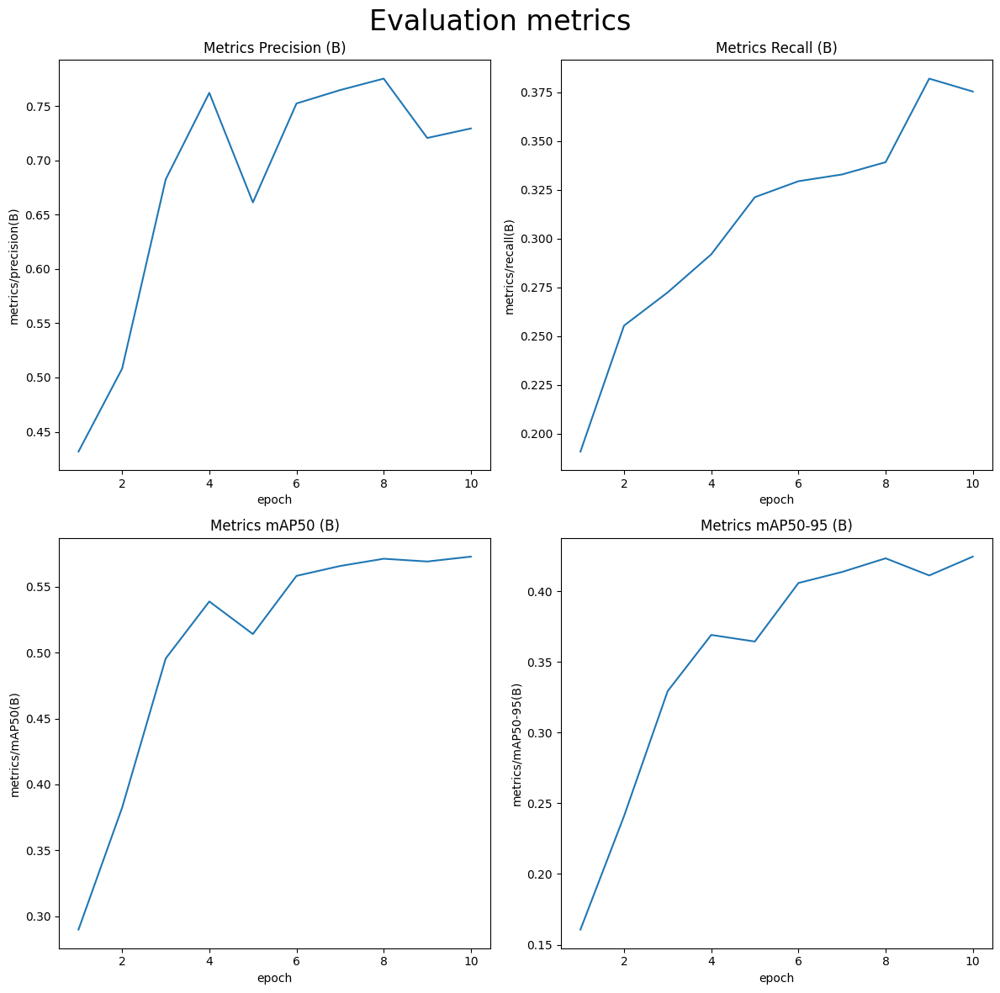

In [30]:
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 12))


sns.lineplot(x='epoch', y='metrics/precision(B)', data=df, ax=axs[0,0])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=df, ax=axs[0,1])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=df, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=df, ax=axs[1,1])

axs[0,0].set(title='Metrics Precision (B)')
axs[0,1].set(title='Metrics Recall (B)')
axs[1,0].set(title='Metrics mAP50 (B)')
axs[1,1].set(title='Metrics mAP50-95 (B)')

# add suptitle and subheader
plt.suptitle('Evaluation metrics', fontsize=24)

# adjust top margin to make space for suptitle
plt.subplots_adjust(top=0.8)

# adjust spacing between subplots
plt.tight_layout()

plt.show()


yolov8s loss:  
Final Loss Values at Epoch 10    
Box Loss - Train: 1.0745, Validation: 1.3764  
Classification Loss - Train: 0.9759, Validation: 1.3654  
DFL Loss - Train: 1.2175, Validation: 1.2459  


yolov8m loss:
Final Loss Values at Epoch 10  
Box Loss - Train: 1.0933, Validation: 1.4057  
Classification Loss - Train: 1.0068, Validation: 1.3836  
DFL Loss - Train: 1.2885, Validation: 1.3321  
  

the results of training using the yolov8m framework boasts similar results to the yolov8s. where in both models, the class loss, box loss and focal loss decrease over time, and start to plateau, however we think that training over 10 epochs is requried to see actual convergence for both train and val losses in each loss category


yolov8s metric reuslts:  
Precision: 0.771      
Recall: 0.365     
mAP50: 0.587      
maAP50-95: 0.448  

yolov8m metric results:
Precision: 0.729  
Recall: 0.375     
mAP50: 0.573     
maAP50-95: 0.424

Despite being the smaller model, yolov8s is performing better overall on our dataset in terms of precision and mAP. this came abis as a surprise because our initial theory was that the larger and more complex framework would perform better. however it didnt. the reason behind this could be due to our dataset not being complex enough, in terms of size and variety. our dataset ended up containing about 9000 images for train, with only one class.

another reason the smaller dataset outperformed the larger one could probably be the fact we didn't train the yolov8m logn enough, which could be inhibiting the yolov8m's true capabilities


# Testing

based off the training results, we will continue testing using the yolov8s over the yolov8m. now we're gonna attempt running our test dataset into this model

In [31]:
model = YOLO('runs/detect/train/weights/best.pt')  # Load your trained model

# Run inference on the test images (no labels needed here)
model.predict(
    source='/content/dataset/ships-aerial-yolov8/images/test',  # path to test images
    imgsz=512,       # same size used during training
    conf=0.25,       # confidence threshold
    save=True        # saves images with bounding boxes
)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1501 /content/dataset/ships-aerial-yolov8/images/test/02e39612d_jpg.rf.cc5483bb711f080d12b644ff62cf977a.jpg: 512x512 1 class0, 11.0ms
image 2/1501 /content/dataset/ships-aerial-yolov8/images/test/04-33800_jpg.rf.c45762dfac8f4c20534434159df41ad2.jpg: 512x512 (no detections), 14.1ms
image 3/1501 /content/dataset/ships-aerial-yolov8/images/test/0__20160905_193458_0c37__-122-34588841807276_37-756417599310865_png.rf.82197eb6853000003827a752a1c02a47.

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'class0'}
 obb: None
 orig_img: array([[[69, 70, 26],
         [69, 70, 26],
         [69, 70, 26],
         ...,
         [92, 90, 42],
         [83, 81, 33],
         [78, 76, 28]],
 
        [[74, 75, 31],
         [74, 75, 31],
         [75, 76, 32],
         ...,
         [80, 78, 30],
         [74, 72, 24],
         [72, 70, 22]],
 
        [[80, 79, 35],
         [82, 81, 37],
         [82, 81, 37],
         ...,
         [75, 73, 25],
         [76, 74, 26],
         [78, 76, 28]],
 
        ...,
 
        [[70, 64, 19],
         [70, 64, 19],
         [72, 66, 21],
         ...,
         [76, 69, 26],
         [74, 67, 24],
         [72, 65, 22]],
 
        [[75, 69, 24],
         [70, 64, 19],
         [69, 63, 18],
         ...,
         [74, 67, 24],
         [72, 65, 22],
         [70, 63, 20]],
 
        [[80, 74, 29],
    

<Figure size 1500x500 with 0 Axes>

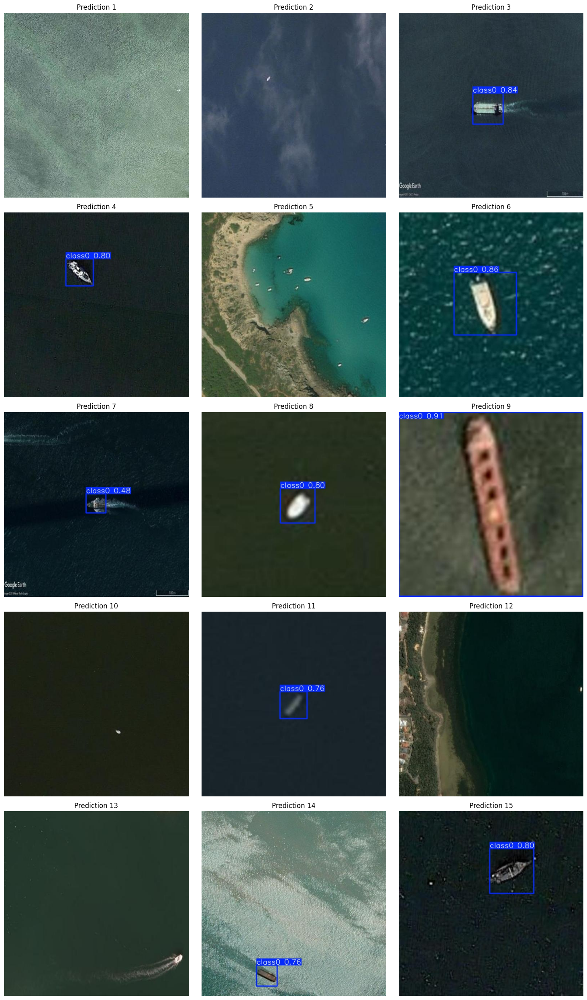

In [32]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

predict_dir = '/content/runs/detect/predict'

# List a few image files
predicted_images = [os.path.join(predict_dir, f) for f in os.listdir(predict_dir) if f.endswith(('.jpg', '.png'))]

num_images = min(15, len(predicted_images))
plt.figure(figsize=(15, 5))

max_images = 15
predicted_images = predicted_images[:max_images]

cols = 3
rows = (len(predicted_images) + cols - 1) // cols
plt.figure(figsize=(5 * cols, 5 * rows))

for i, img_path in enumerate(predicted_images):
    img = mpimg.imread(img_path)
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img)
    plt.title(f'Prediction {i + 1}')
    plt.axis('off')

plt.tight_layout()
plt.show()

In [33]:
model.val(
    data='/content/dataset/ships-aerial-yolov8/data.yaml',
    split='test',
    imgsz=512
)

Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 485.7±164.1 MB/s, size: 13.4 KB)


val: Scanning /content/dataset/ships-aerial-yolov8/labels/test... 1501 images, 51 backgrounds, 0 corrupt: 100%|██████████| 1501/1501 [00:01<00:00, 1351.19it/s]

val: New cache created: /content/dataset/ships-aerial-yolov8/labels/test.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 94/94 [00:16<00:00,  5.67it/s]


                   all       1501       2326      0.549      0.453      0.518      0.323
Speed: 0.4ms preprocess, 6.1ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/val


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7c89c4644a10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

the test set resulted in these scores for each evaluation metric

precision(B):0.5490584734868128

recall(B)':0.45279831309869806

mAP50(B)':0.5180697414787695

mAP50-95(B)':0.32333980179386584

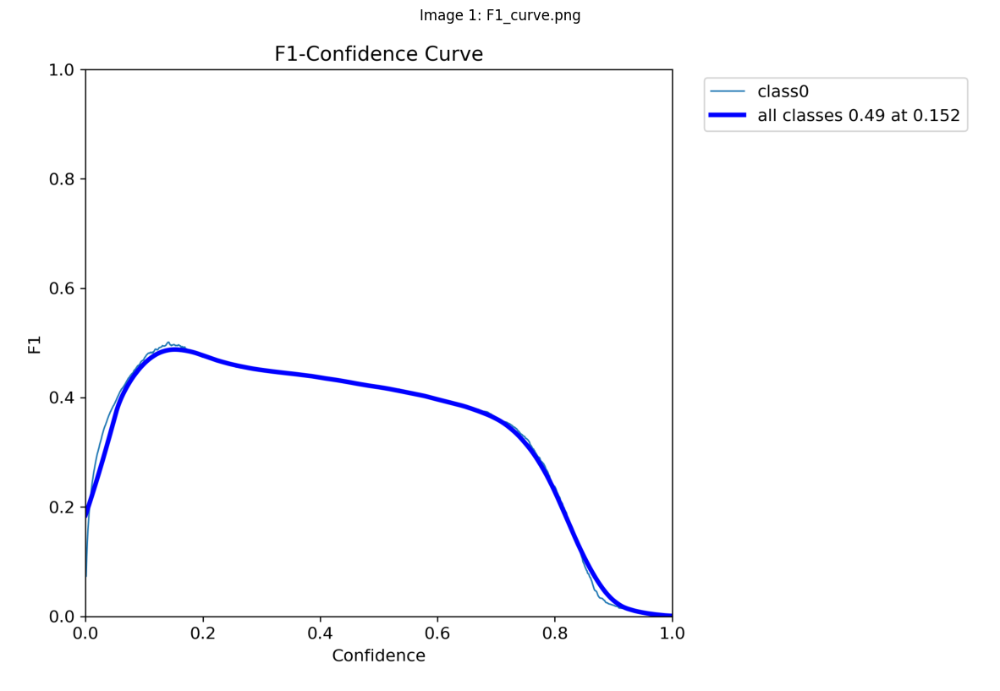

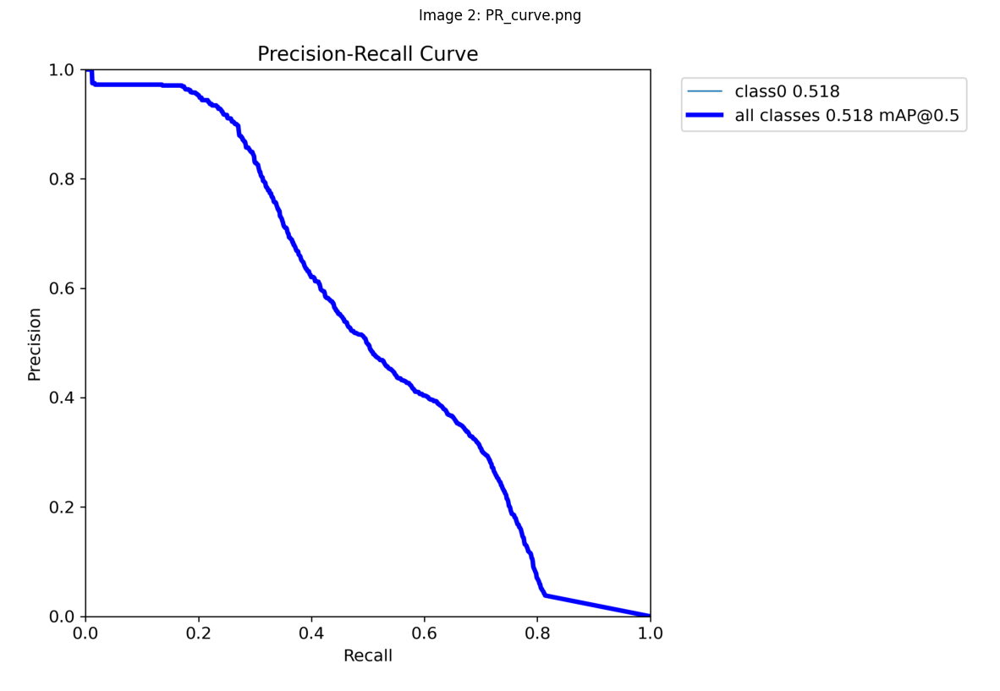

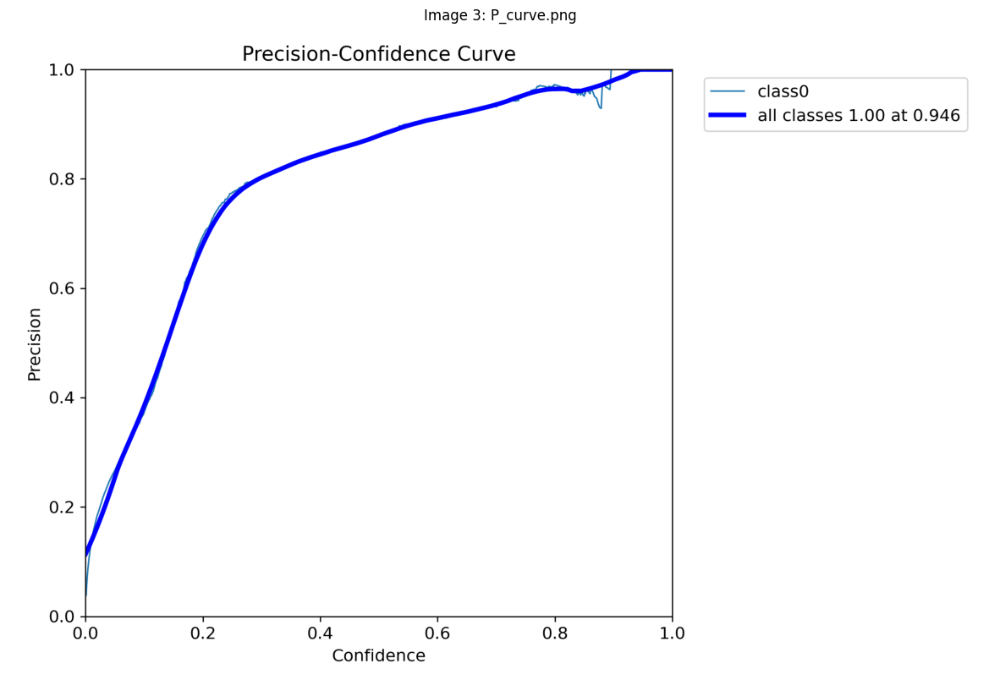

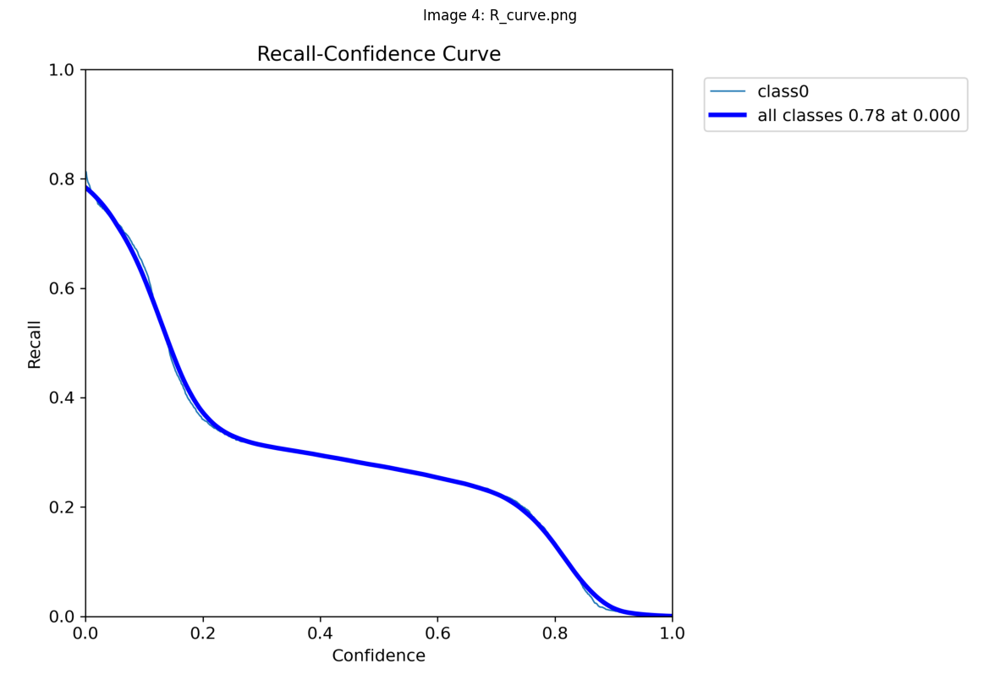

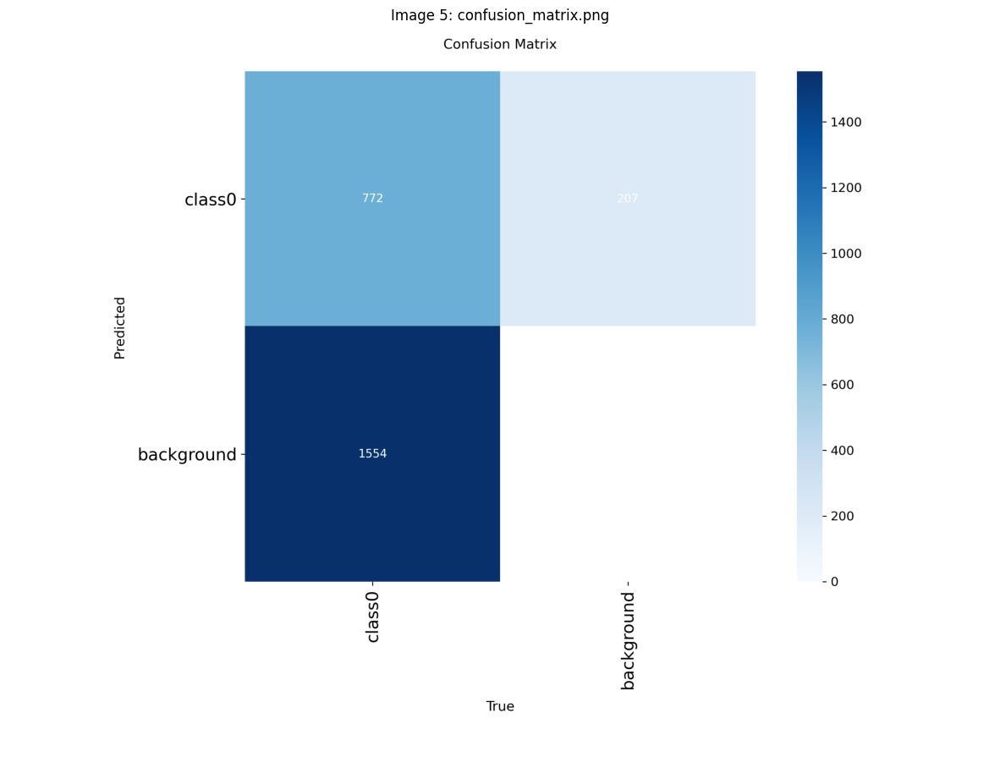

...

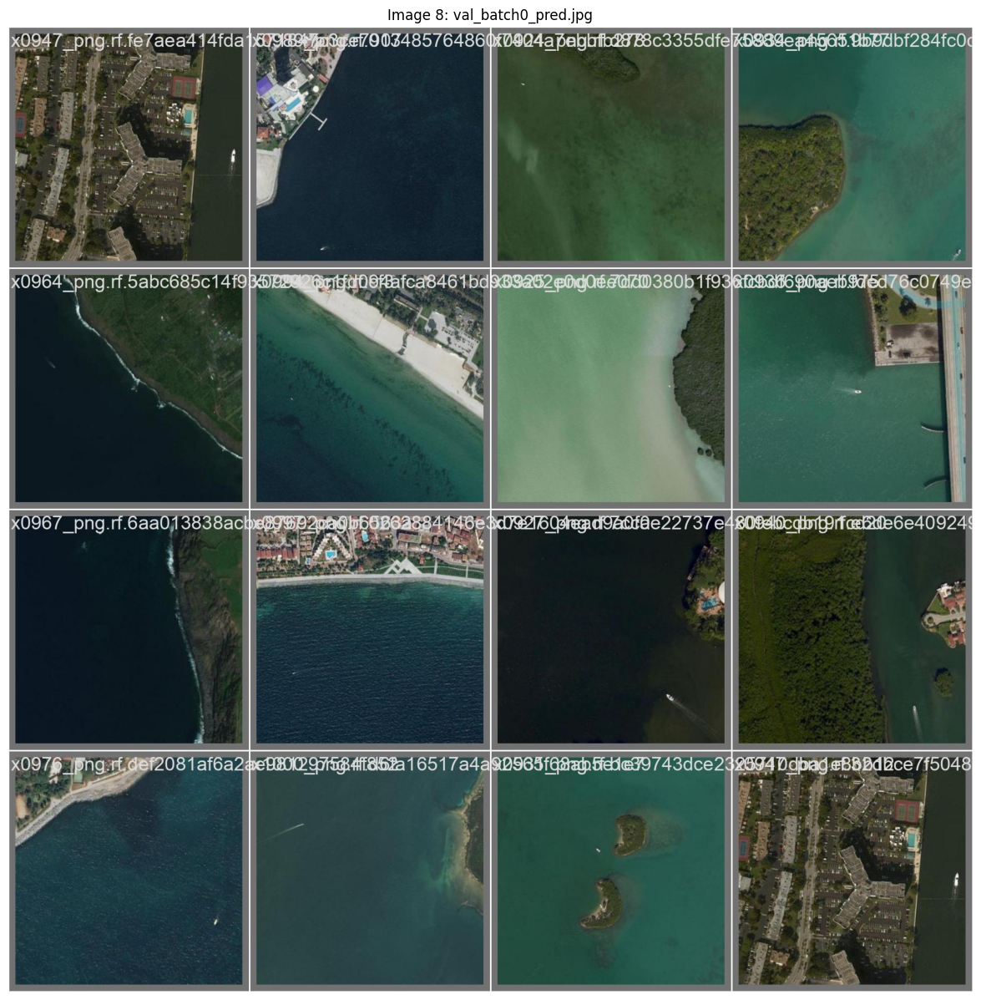

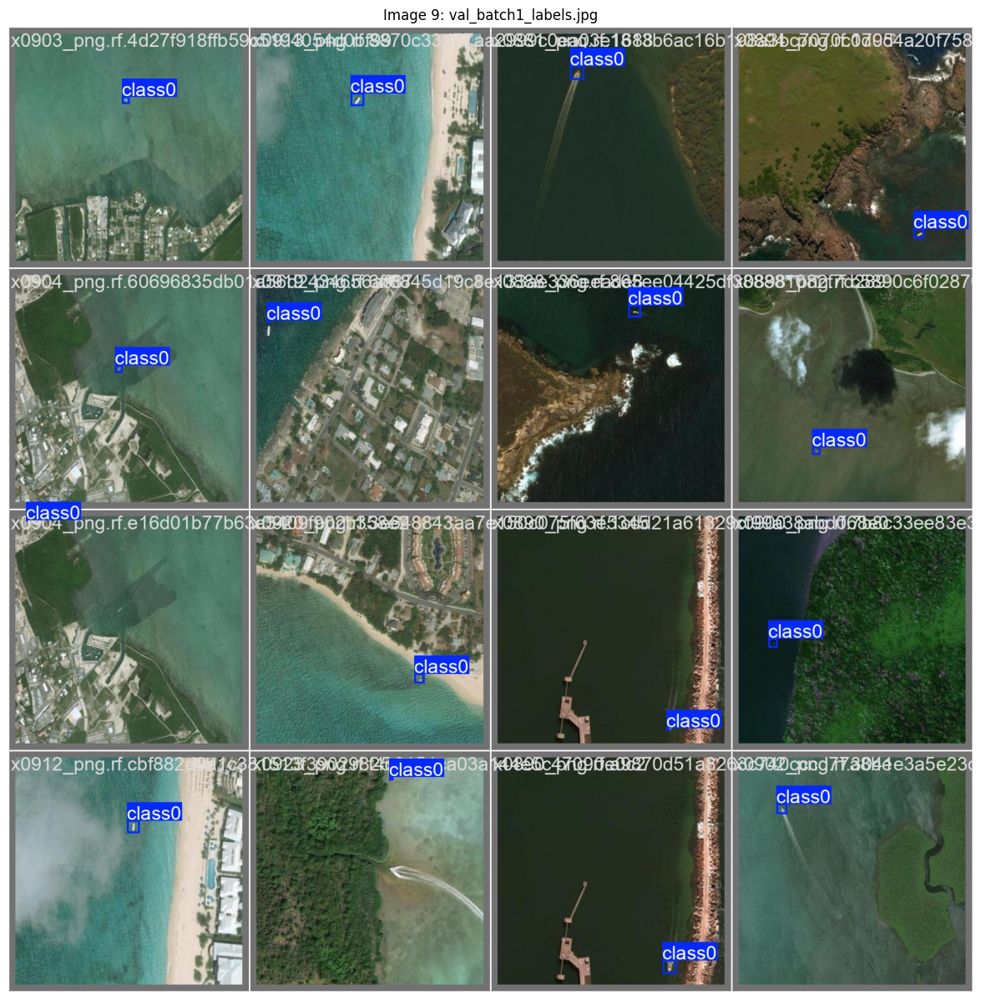

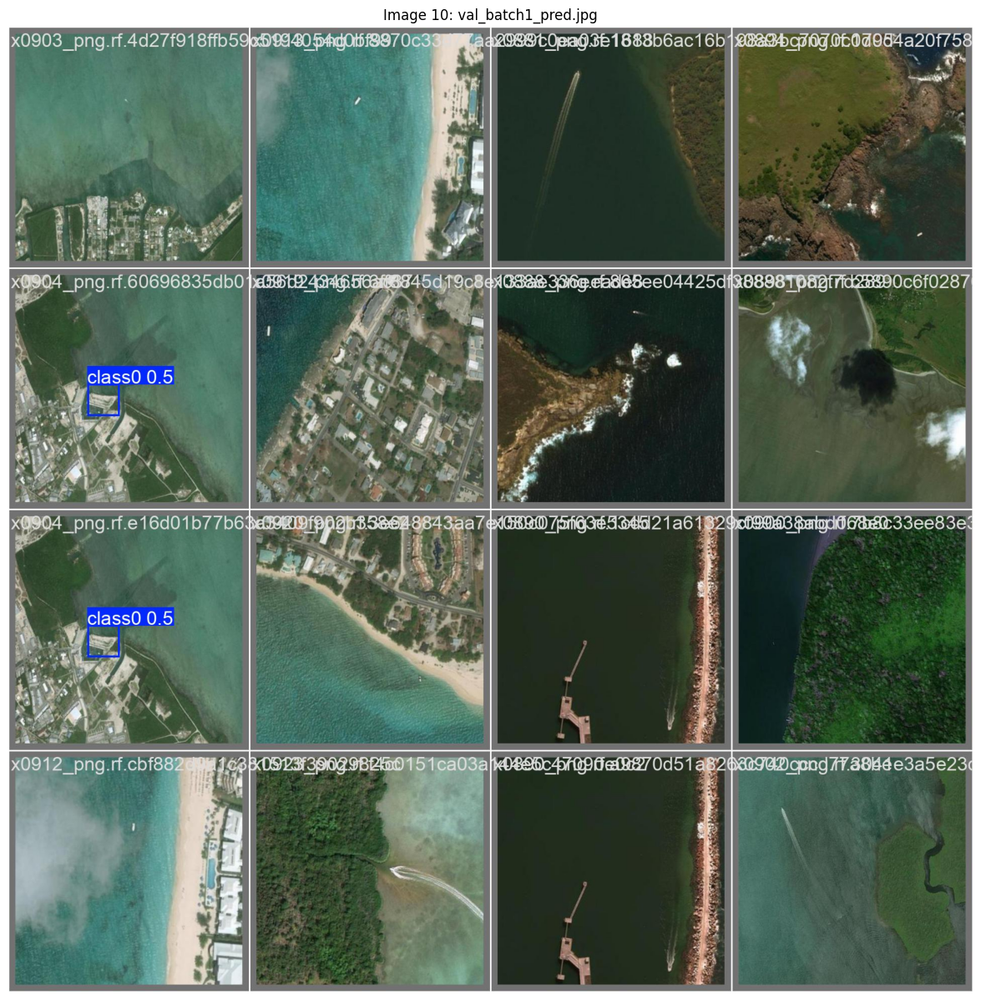

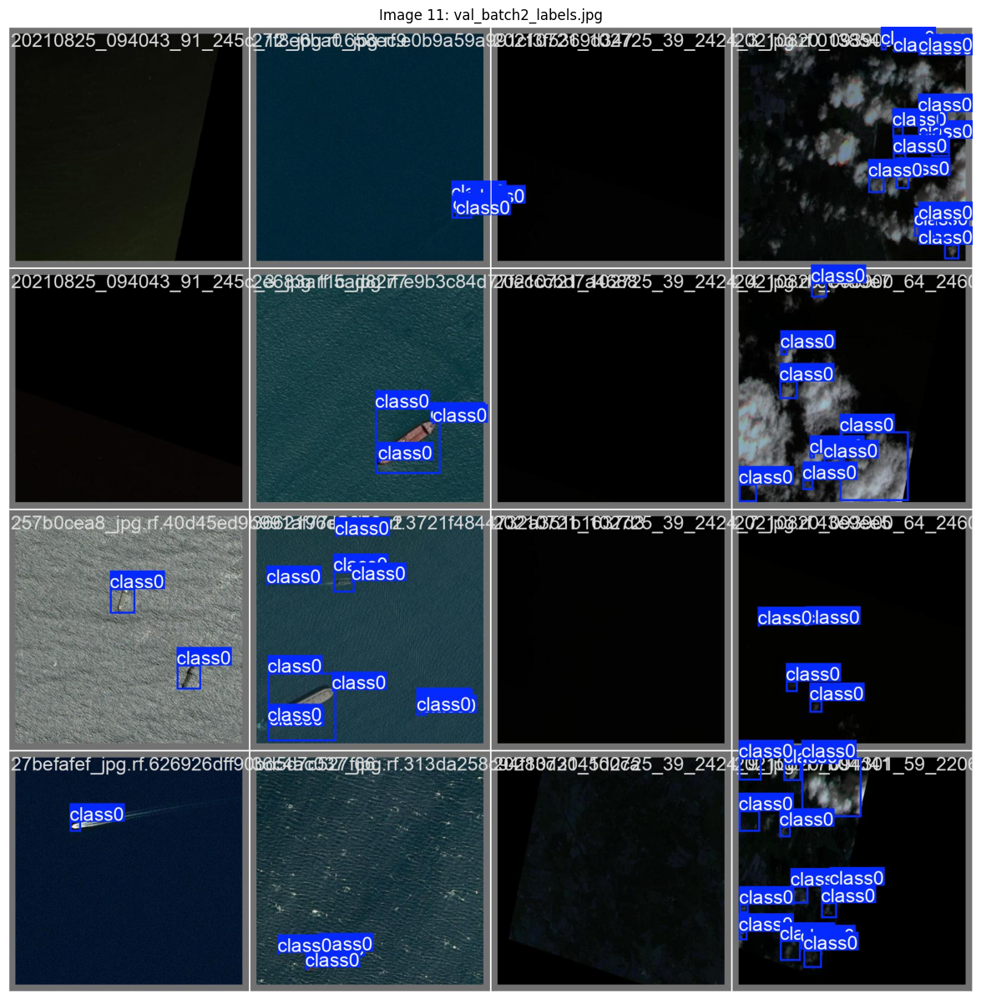

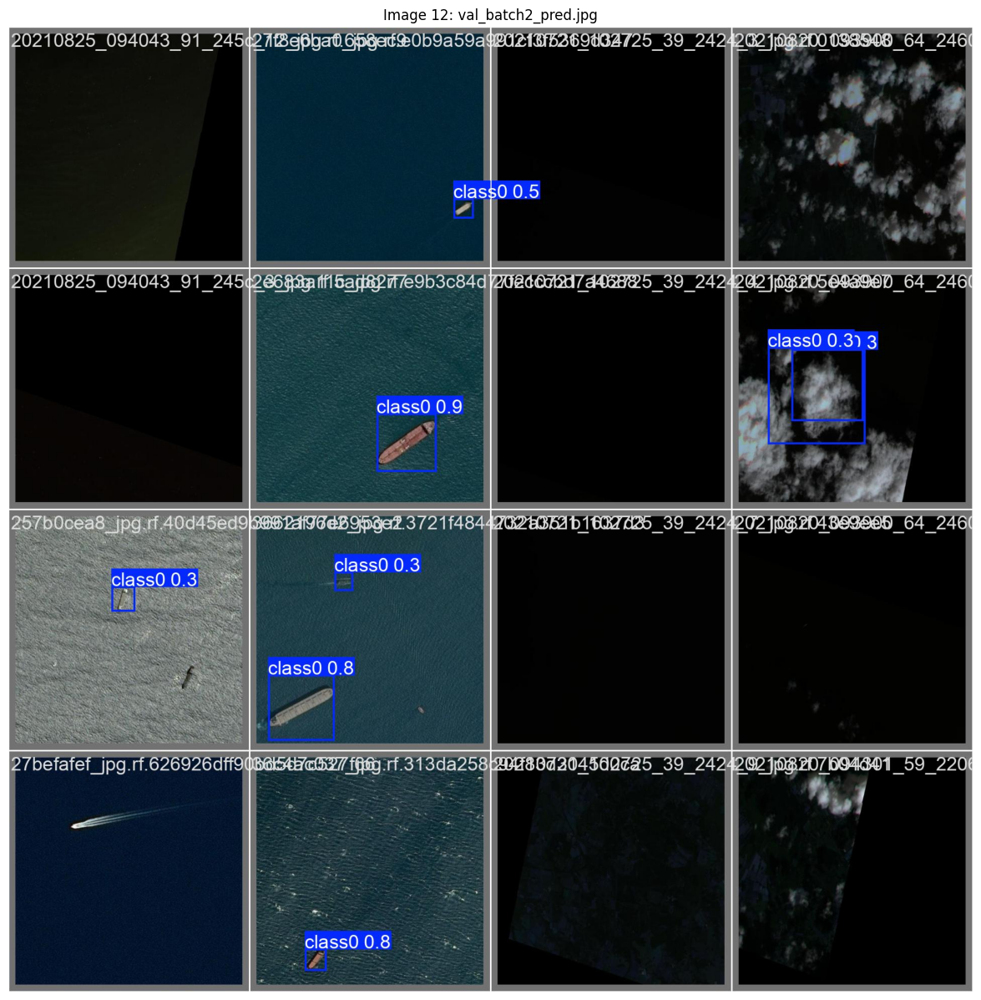

In [34]:
import os
import cv2
from matplotlib import pyplot as plt

# Path to validation output folder
val_dir = '/content/runs/detect/val'

# Collect image file paths (adjust extensions if needed)
image_files = sorted([
    os.path.join(val_dir, f)
    for f in os.listdir(val_dir)
    if f.lower().endswith(('.jpg', '.jpeg', '.png'))
])

# Display each image one at a time
for idx, img_path in enumerate(image_files):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # convert BGR to RGB for matplotlib

    plt.figure(figsize=(15, 15))
    plt.imshow(img)
    plt.title(f"Image {idx+1}: {os.path.basename(img_path)}")
    plt.axis('off')
    plt.show()


##### F1-confidence
The F1 score initially increases with confidence, reaching its peak at a relatively low threshold of around 0.15. This indicates that the model performs best when even low-confidence predictions are considered, suggesting the model may be underconfident, assigning low confidence scores even when predictions are correct. Beyond this point, the f1 score gradually declines, this is likely due to the recall dropping as the confidence increases, as seen in the recall-conf graph, meaning that fewer predictions meet the higher conf reuqirement.

##### Precision-confidence
The graph shows a clear upward trend, precision steadily improves with higher confidence thresholds, eventually approaching 1.0 as the threshold nears 1.0. This indicates that the model is well calibrated in terms of precision, meaning when it assigns high confidence to a prediction, it is usually correct.

##### recall-confidence
for the recall confidence graph, at a confidence thresholds near 0, recall is high—around 0.8, meaning the model is identifying most of the true positives when it accepts predictions with low confidence. However as the threshold increases recall drops sharply (ard 0.1-0.3 conf), and continue to decline, eventually reaching 0 at around 0.8 conf level

##### conclusion
From the comparison between the actual data and our predicted data, we can see that at low thresholds, the model is able to detect almost all ships (indicating high recall), but when threshold is low, precision is also low (as shown on the graph), resulting in predicitons of some clouds or waves as ships.
At higher thresholds (0.8 and above), the model is able to detect ships, in images where the ship is very clearly seen (high precision), but is unable to detect smaller, more hidden, or blurry ships, which results in low recall.

in some of our raw images+labels, it can be seen that even from the raw data, the labels are bounded to areas which do not contain ships. this can be seen from some of the sample images, where the raw labels, bounded areas which do nnot contain ships. as a result, images where its supposedly classified as bacground, ends up having true labels of class0(ships.). this is proven in our classification matrix. where alot oof our predictions are backgrounds, but its true labels is class0(ships), even though initially, they dont even containn ships

In [37]:
# Non-Maximum Suppression (NMS) Implementation
import numpy as np
import cv2
import matplotlib.pyplot as plt

def non_max_suppression(boxes, scores, iou_threshold):
    if len(boxes) == 0:
        return []

    boxes = np.array(boxes)
    scores = np.array(scores)
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    areas = (x2 - x1 + 1) * (y2 - y1 + 1)
    order = scores.argsort()[::-1]

    keep = []
    while order.size > 0:
        i = order[0]
        keep.append(i)

        xx1 = np.maximum(x1[i], x1[order[1:]])
        yy1 = np.maximum(y1[i], y1[order[1:]])
        xx2 = np.minimum(x2[i], x2[order[1:]])
        yy2 = np.minimum(y2[i], y2[order[1:]])

        w = np.maximum(0.0, xx2 - xx1 + 1)
        h = np.maximum(0.0, yy2 - yy1 + 1)
        inter = w * h
        ovr = inter / (areas[i] + areas[order[1:]] - inter)

        inds = np.where(ovr <= iou_threshold)[0]
        order = order[inds + 1]

    return keep



WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1573 /content/dataset/ships-aerial-images/test/images/02e39612d_jpg.rf.cc5483bb711f080d12b644ff62cf977a.jpg: 512x512 1 class0, 11.8ms
image 2/1573 /content/dataset/ships-aerial-images/test/images/04-33800_jpg.rf.c45762dfac8f4c20534434159df41ad2.jpg: 512x512 (no detections), 11.0ms
image 3/1573 /content/dataset/ships-aerial-images/test/images/043d8815e_jpg.rf.702fa31e03a8a1c28e5fb63c561ac16e.jpg: 512x512 (no detections), 11.0ms
image 4/1573 /con

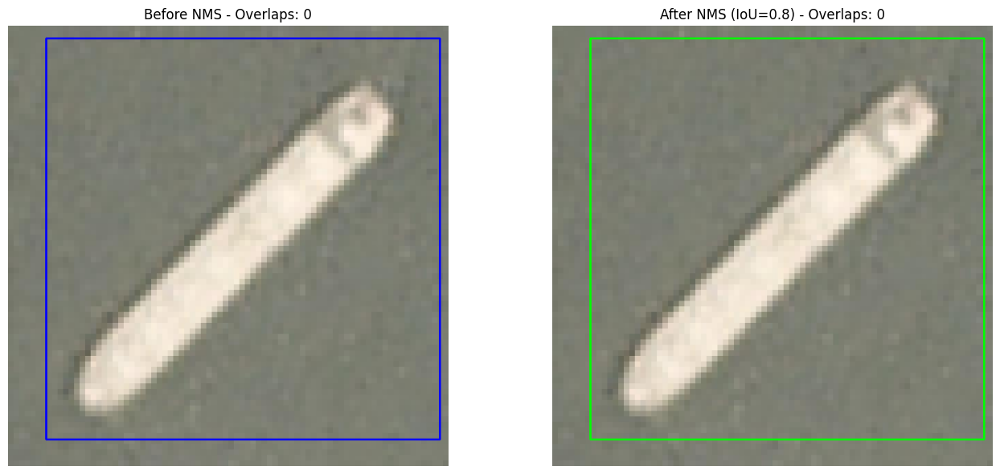

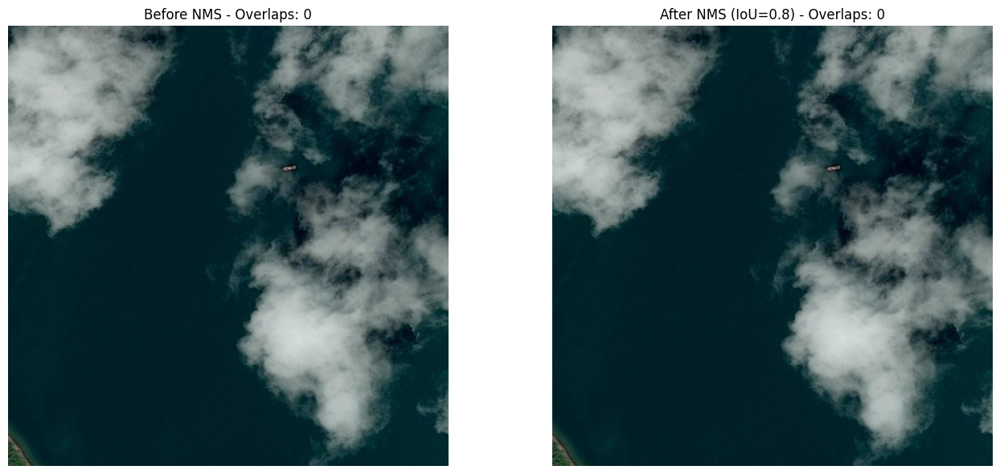

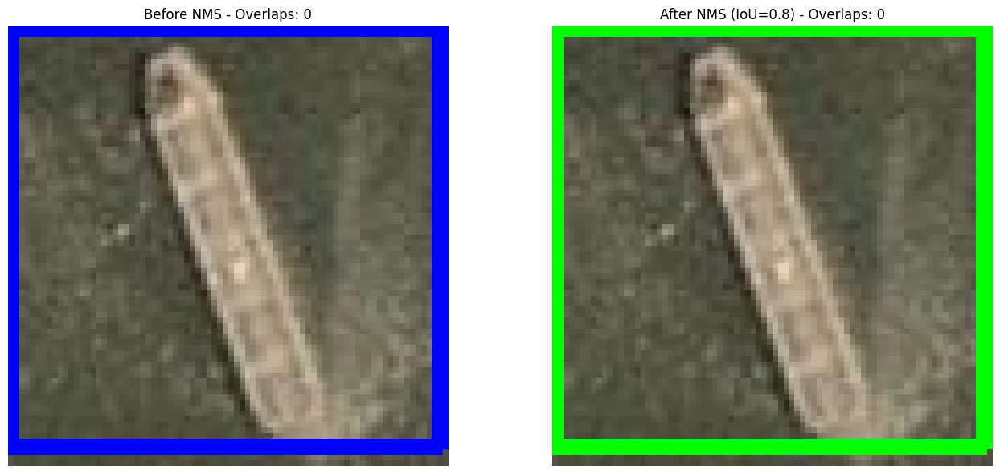

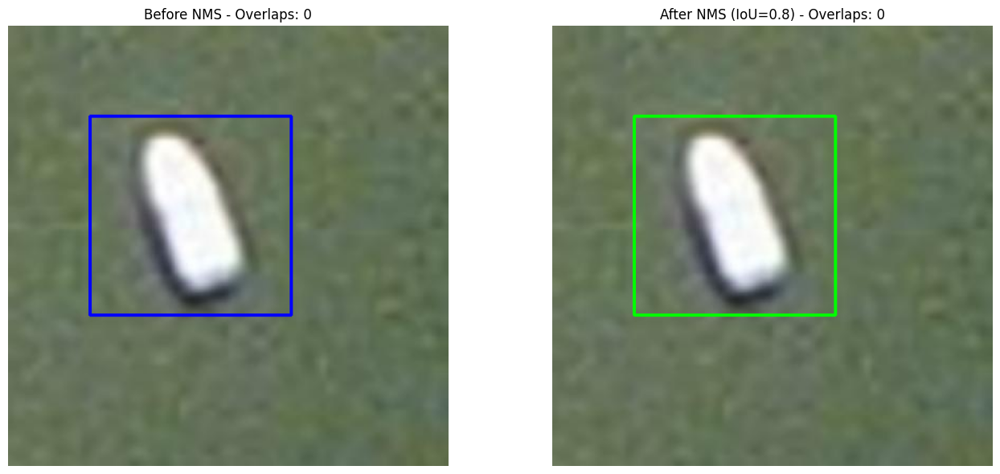

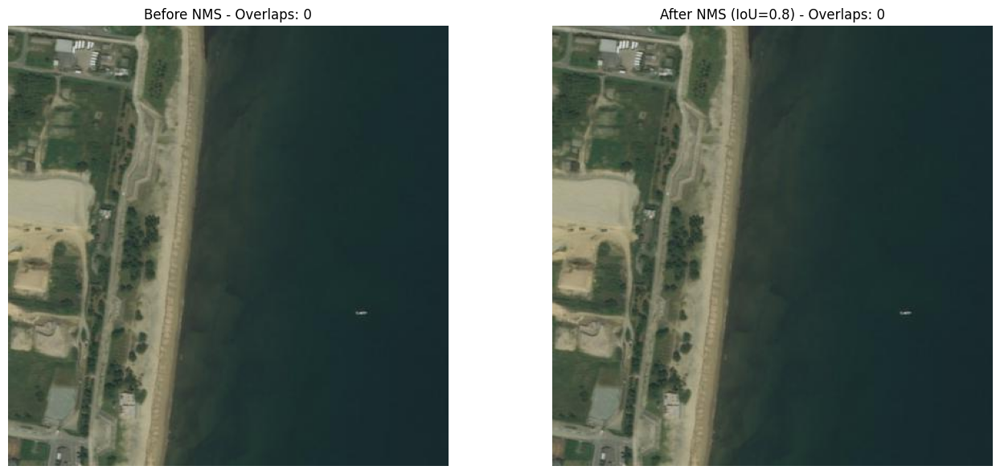

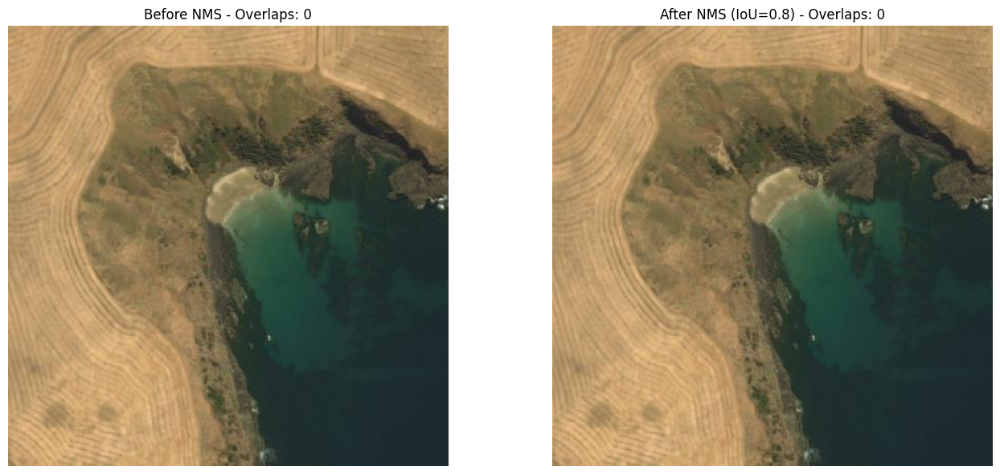

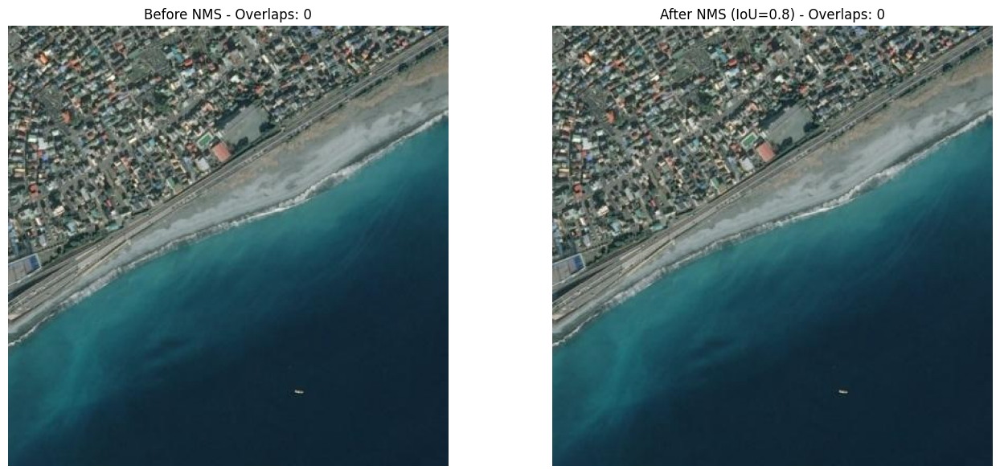

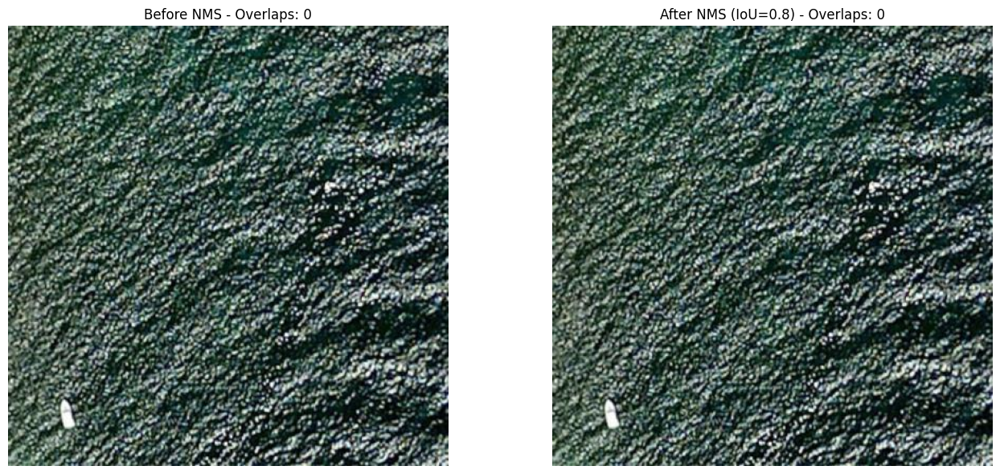

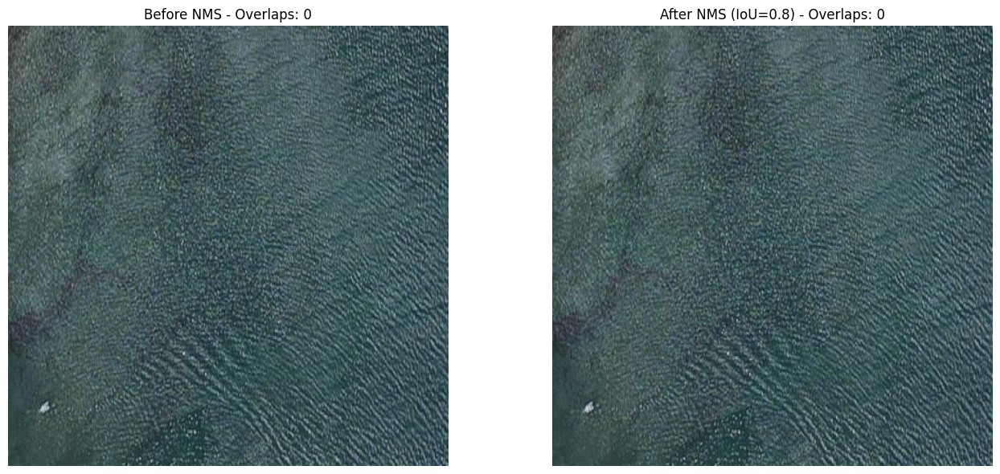

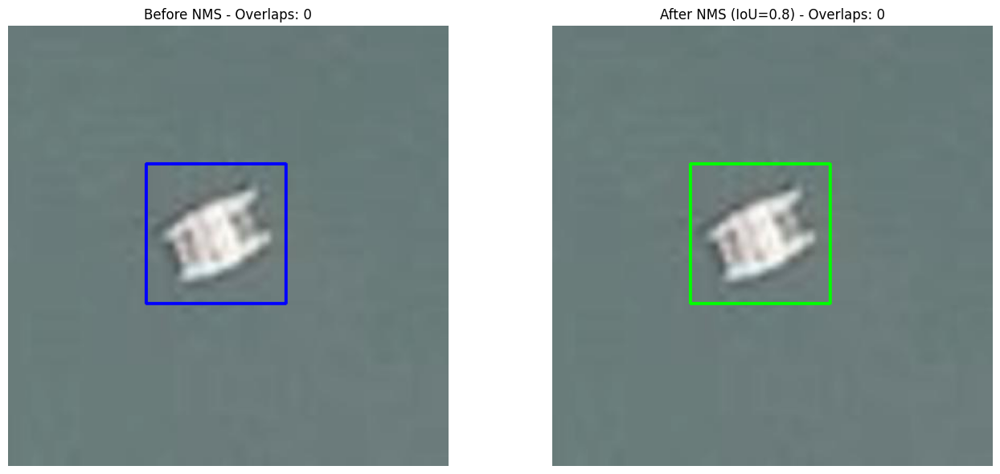

In [45]:
import random
# Example comparison before vs after NMS
results = model.predict(source='/content/dataset/ships-aerial-images/test/images', save=False)

random_indices = random.sample(range(len(results)), min(10, len(results)))

def compute_overlap_count(boxes):
    count = 0
    for i in range(len(boxes)):
        for j in range(i + 1, len(boxes)):
            box_a = shapely_box(*boxes[i])
            box_b = shapely_box(*boxes[j])
            if box_a.intersects(box_b):
                count += 1
    return count

for idx, i in enumerate(random_indices):
    r = results[i]
    im_array = r.orig_img.copy()
    boxes = r.boxes.xyxy.cpu().numpy()
    scores = r.boxes.conf.cpu().numpy()

    before_overlap = compute_overlap_count(boxes)

    keep = non_max_suppression(boxes, scores, iou_threshold=0.8)
    filtered_boxes = boxes[keep]
    after_overlap = compute_overlap_count(filtered_boxes)

    img_before = im_array.copy()
    for box in boxes:
        x1, y1, x2, y2 = box.astype(int)
        cv2.rectangle(img_before, (x1, y1), (x2, y2), (255,0,0), 2)

    img_after = im_array.copy()
    for box in filtered_boxes:
        x1, y1, x2, y2 = box.astype(int)
        cv2.rectangle(img_after, (x1, y1), (x2, y2), (0,255,0), 2)

    fig, axs = plt.subplots(1, 2, figsize=(14, 6))
    axs[0].imshow(cv2.cvtColor(img_before, cv2.COLOR_BGR2RGB))
    axs[0].set_title(f"Before NMS - Overlaps: {before_overlap}")
    axs[0].axis("off")

    axs[1].imshow(cv2.cvtColor(img_after, cv2.COLOR_BGR2RGB))
    axs[1].set_title(f"After NMS (IoU=0.8) - Overlaps: {after_overlap}")
    axs[1].axis("off")
    plt.tight_layout()
    plt.show()

The reason why there is no visible difference between the output images labeled Before NMS and After NMS is because the Ultralytics YOLOv8 model automatically applies Non-Maximum Suppression (NMS) during inference. When we use model.predict(), the bounding boxes it returns have already been filtered using NMS to remove redundant or overlapping detections. Therefore, by the time we retrieve the bounding box coordinates (r.boxes.xyxy), we are already working with a cleaned set of predictions. Applying our custom NMS function again to these filtered results has little to no effect, as there are no significant overlaps left to suppress. This is why both visualizations appear identical, there are simply no duplicate boxes remaining for the custom NMS to remove.

# Existing challenges and future oppurtunities

the mainn challenge from our project is that the subpar metric results from training and testing. from our results, our model fails to detect ships that are not clearly visible. either because it is small, hindered or covered by other objects.  as a result, our model is unable to detect ships that are not very clearly seen with high confidence. 

after training, there also posed a challenge with our raw data. where alot of our raw data had misleading bounding boxes. however, our test results differed from the raw data (which is good, because it actually detects background as background), as a result this diffeence in raw and test and result caused drops and subpar results in our evaluation metrics

some other future oppurtunities we can seize is one, the parameters of training. from the results of the training, we cna see that the graphs havent fully plateued yet, meaning that there were insuffiencet epochs for convergence. in the future we could train the model over longer epochs to potentially yield better results. we could also potentially use grid search to tune our hyperparameters, usign different learning rates, conf thresholds etc.

in our current iteration, we used the yolov8s and yolov8ms model, which are the mid-range  yolo architectures. in the future we'll try to use more complex architectures such as yolov8x or yolov8l. hoping to improve the detecting ability of our model.

other future changes we could do is to properly filter or clean the annotations of images that are falsely labelled, cus these falsely labelled raw data penalizes our recall and precision when we actually  predict correctly